## Import

In [88]:
import mne
import numpy as np
import scipy
import os
import math
from scipy import signal as sg
from matplotlib import pyplot as plt
from mne.preprocessing import ICA, create_ecg_epochs, create_eog_epochs, read_ica
import pandas as pd

## Load Data

In [89]:
directory_path = "D:/EEG RESEARCH DATA"
os.chdir(directory_path)

raw = mne.io.read_raw_brainvision("20240418_mat5mins/20240418_B98_jikken_0003.vhdr")

# Reconstruct the original events from our Raw object
events, event_ids = mne.events_from_annotations(raw)

Extracting parameters from 20240418_mat5mins/20240418_B98_jikken_0003.vhdr...
Setting channel info structure...
Used Annotations descriptions: ['New Segment/', 'Stimulus/S  1']


In [90]:
montage = mne.channels.make_standard_montage('standard_1020')
raw.set_channel_types({'ECG':'ecg'})
raw.set_channel_types({'vEOG':'eog'})
raw.set_channel_types({'hEOG':'eog'})

<RawBrainVision | 20240418_B98_jikken_0003.eeg, 67 x 945480 (945.5 s), ~60 kB, data not loaded>

In [91]:
raw.set_montage(montage)
#fig = raw.plot_sensors(show_names=True)

<RawBrainVision | 20240418_B98_jikken_0003.eeg, 67 x 945480 (945.5 s), ~83 kB, data not loaded>

### Segment Grouping

In [92]:
fs = 1000

trg0 = events[3,0] #Experiment Begin 
trg1 = events[4,0] #Task Begin
trg2 = events[-2,0] #Task End
trg3 = events[-1,0] #Experiment End

tmin = trg0/fs
tmax = trg3/fs

# #Segment in Samples
# seg1 = trg1 - trg0
# seg2 = trg2 - trg0
# seg3 = trg3 - trg0

# #Segment in ms
# newseg1 = int(seg1/fs)
# newseg2 = int(seg2/fs)
# newseg3 = int(seg3/fs)

## ECG Analysis

### Using My Pan Tompkins Algorithm

In [6]:
##Testing only on ECG, T = 60 secs
#raw_ecg = raw.copy().pick_types(eeg=False, eog=False, ecg=True).crop(tmin = 60, tmax = 120) #make a copy


#Testing only on ECG, T = Whole experiment actual time
raw_ecg = raw.copy().pick_types(eeg=False, eog=False, ecg=True).crop(tmin = tmin, tmax = tmax) #make a copy

In [7]:
mne_ecg, mne_time = raw_ecg[:]
mne_ecg = -mne_ecg.T

####  Pan Tompkins Alogrithm

In [8]:
class pan_tompkins_qrs():
    def bpf(self,x):
        
        
        
        y_filtered = None

        #Results will be delayed 16 Samples
        y = x.copy()

        #Low Pass Filter
        #y(n) = 2y(n-1) - y(n-2) + x(n) - 2x(n-6) + x(n-12)
        for n in range(len(x)):
            y[n] = x[n]

            if (n >= 1):
                y[n] += 2*y[n-1]
            if (n >= 2):
                y[n] -= y[n-2]
            if (n >= 6):
                y[n] -= 2*x[n-6]
            if (n >= 12):
                y[n] += x[n-12]
        
        y_filtered = y.copy()

        #High Pass Filter
        #y(n) = 32x(n-16) - y(n-1) - x(n) + x(n-32)
        for n in range(len(x)):
            y_filtered[n] = -1*y[n]

            if (n >= 1):
                y_filtered[n] -= y_filtered[n-1]
            if (n >= 16):
                y_filtered[n] += 32*y[n-16]
            if(n >= 32):
                y_filtered[n] += y[n-32]
        
        #Normalization
        max_val = max(max(y_filtered), -min(y_filtered))
        y_filtered = y_filtered/max_val

        return y_filtered
    
    def derivative(self,x,fs):
        
        #Results will be delayed for 2 samples
        y_derived = x.copy()
        
        #Derivative Filter
        #y(n) = [-x(n-2) - 2x(n-1) + 2x(n+1) + x(n+2)]/8
        for n in range(len(x)):
            y_derived[n] = 0

            if (n >= 1):
                y_derived[n] -= 2*x[n-1]
            if (n >= 2):
                y_derived[n] -= x[n-2]
            
            ###Not sure what this part is for###
            if (n >= 2 and n <= len(x)-2):
                y_derived[n] += 2*x[n+1]
            if (n >= 2 and n<= len(x)-3):
                y_derived[n] += x[n+2]
            ###Not sure what this part is for###

            ###Not sure why does it has to be times to "fs"###
            y_derived[n] = (y_derived[n]*fs)/8
            ###Not sure why does it has to be times to "fs"###
        
        return y_derived
    
    def squaring(self,x):
        
        y_squared = x.copy()

        for n in range(len(x)):
            y_squared[n] = x[n]**2

        return y_squared
    
    def moving_window_integration(self,x,fs):
        # Initialize result and window size for integration
        y = x.copy()
        win_size = round(0.150 * fs)
        sum = 0

        # Calculate the sum for the first N terms
        for j in range(win_size):
            sum += x[j]/win_size
            y[j] = sum
        
        # Apply the moving window integration using the equation given
        for n in range(win_size,len(x)):  
            sum += x[n]/win_size
            sum -= x[n-win_size]/win_size
            y[n] = sum

        return y

    def solve(self,x,fs):

        # Convert the input signal into numpy array
        input_signal = x.copy()

        # Bandpass Filter
        global bpass
        bpass = self.bpf(input_signal.copy())

        # Derivative Function
        global der
        der = self.derivative(bpass.copy(),fs)

        # Squaring Function
        global sqr
        sqr = self.squaring(der.copy())

        # Moving Window Integration Function
        global mwin
        mwin = self.moving_window_integration(sqr.copy(),fs)

        return mwin


In [9]:
class heart_rate():
    def __init__(self,x,fs):
        #Initialize Variables
        self.RR1, self.RR2, self.probable_peaks, self.r_locs, self.peaks, self.result = ([] for i in range(6))
        self.SPKI, self.NPKI, self.Threshold_I1, self.Threshold_I2, self.SPKF, self.NPKF, self.Threshold_F1, self.Threshold_F2 = (0 for i in range(8))

        self.T_wave = False
        self.m_win = mwin
        self.b_pass = bpass
        self.fs = fs
        self.signal = x
        self.win_150ms = round(0.15*self.fs)

        self.RR_Low_Limit = 0
        self.RR_High_Limit = 0
        self.RR_Missed_Limit = 0
        self.RR_Average1 = 0

    def approx_peak(self):
        ###Change from the original code by making the size to (A x 1) instead of (A x )###
        slopes = sg.fftconvolve(self.m_win, np.full((25,1),1)/25, mode='same')
        ###Change from the original code by making the size to (A x 1) instead of (A x )###

        # for i in range(round(0.5*self.fs) + 1,len(slopes)-1):
        for i in range(0,len(slopes)-1):
            if (slopes[i] > slopes[i-1]) and (slopes[i+1] <slopes[i]):
                self.peaks.append(i)

    def adjust_rr_interval(self, ind):
        self.RR1 = np.diff(self.peaks[max(0,ind - 8) : ind + 1])/self.fs  

        # Calculating RR Averages
        self.RR_Average1 = np.mean(self.RR1)
        RR_Average2 = self.RR_Average1
        
        # Finding the eight most recent RR intervals lying between RR Low Limit and RR High Limit  
        if (ind >= 8):
            for i in range(0, 8):
                if (self.RR_Low_Limit < self.RR1[i] < self.RR_High_Limit): 
                    self.RR2.append(self.RR1[i])

                    if (len(self.RR2) > 8):
                        self.RR2.remove(self.RR2[0])
                        RR_Average2 = np.mean(self.RR2)    

        # Adjusting the RR Low Limit and RR High Limit
        if (len(self.RR2) > 7 or ind < 8):
            self.RR_Low_Limit = 0.92 * RR_Average2        
            self.RR_High_Limit = 1.16 * RR_Average2
            self.RR_Missed_Limit = 1.66 * RR_Average2
    
    def searchback(self, peak_val, RRn, sb_win):
        # Check if the most recent RR interval is greater than the RR Missed Limit
        if (RRn > self.RR_Missed_Limit):
            # Initialize a window to searchback  
            win_rr = self.m_win[peak_val - sb_win + 1 : peak_val + 1] 

            # Find the x locations inside the window having y values greater than Threshold I1             
            coord = np.asarray(win_rr > self.Threshold_I1).nonzero()[0]

            # Find the x location of the max peak value in the search window
            if (len(coord) > 0):
                for pos in coord:
                    if (win_rr[pos] == max(win_rr[coord])):
                        x_max = pos
                        break
            else:
                x_max = None
    
            # If the max peak value is found
            if (x_max is not None):   
                # Update the thresholds corresponding to moving window integration
                self.SPKI = 0.25 * self.m_win[x_max] + 0.75 * self.SPKI                         
                self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
                self.Threshold_I2 = 0.5 * self.Threshold_I1         

                # Initialize a window to searchback 
                win_rr = self.b_pass[x_max - self.win_150ms: min(len(self.b_pass) -1, x_max)]  

                # Find the x locations inside the window having y values greater than Threshold F1                   
                coord = np.asarray(win_rr > self.Threshold_F1).nonzero()[0]

                # Find the x location of the max peak value in the search window
                if (len(coord) > 0):
                    for pos in coord:
                        if (win_rr[pos] == max(win_rr[coord])):
                            r_max = pos
                            break
                else:
                    r_max = None

                # If the max peak value is found
                if (r_max is not None):
                # Update the thresholds corresponding to bandpass filter
                    if self.b_pass[r_max] > self.Threshold_F2:                                                        
                        self.SPKF = 0.25 * self.b_pass[r_max] + 0.75 * self.SPKF                            
                        self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
                        self.Threshold_F2 = 0.5 * self.Threshold_F1      

                        # Append the probable R peak location                      
                        self.r_locs.append(r_max)

    def find_t_wave(self,peak_val,RRn,ind,prev_ind):
        '''
        T Wave Identification
        :param peak_val: peak location in consideration
        :param RRn: the most recent RR interval
        :param ind: current index in peaks array
        :param prev_ind: previous index in peaks array
        '''

        if (self.m_win[peak_val] >= self.Threshold_I1): 
            if (ind > 0 and 0.20 < RRn < 0.36):
                # Find the slope of current and last waveform detected        
                curr_slope = max(np.diff(self.m_win[peak_val - round(self.win_150ms/2) : peak_val + 1]))
                last_slope = max(np.diff(self.m_win[self.peaks[prev_ind] - round(self.win_150ms/2) : self.peaks[prev_ind] + 1]))
            
                # If current waveform slope is less than half of last waveform slope
                if (curr_slope < 0.5*last_slope):  
                    # T Wave is found and update noise threshold                      
                    self.T_wave = True                             
                    self.NPKI = 0.125 * self.m_win[peak_val] + 0.875 * self.NPKI 

            if (not self.T_wave):
                # T Wave is not found and update signal thresholds
                if (self.probable_peaks[ind] > self.Threshold_F1):   
                    self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI                                         
                    self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

                    # Append the probable R peak location
                    self.r_locs.append(self.probable_peaks[ind])  

                else:
                    self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI
                    self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                   

        # Update noise thresholds
        elif (self.m_win[peak_val] < self.Threshold_I1) or (self.Threshold_I1 < self.m_win[peak_val] < self.Threshold_I2):
            self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
            self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


    def adjust_thresholds(self,peak_val,ind):
        '''
        Adjust Noise and Signal Thresholds During Learning Phase
        :param peak_val: peak location in consideration
        :param ind: current index in peaks array
        '''

        if (self.m_win[peak_val] >= self.Threshold_I1): 
            # Update signal threshold
            self.SPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.SPKI

            if (self.probable_peaks[ind] > self.Threshold_F1):                                            
                self.SPKF = 0.125 * self.b_pass[ind] + 0.875 * self.SPKF 

                # Append the probable R peak location
                self.r_locs.append(self.probable_peaks[ind])  

            else:
                # Update noise threshold
                self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF                                    
            
        # Update noise thresholds    
        elif (self.m_win[peak_val] < self.Threshold_I2) or (self.Threshold_I2 < self.m_win[peak_val] < self.Threshold_I1):
            self.NPKI = 0.125 * self.m_win[peak_val]  + 0.875 * self.NPKI  
            self.NPKF = 0.125 * self.b_pass[ind] + 0.875 * self.NPKF


    def update_thresholds(self):
        '''
        Update Noise and Signal Thresholds for next iteration
        '''

        self.Threshold_I1 = self.NPKI + 0.25 * (self.SPKI - self.NPKI)
        self.Threshold_F1 = self.NPKF + 0.25 * (self.SPKF - self.NPKF)
        self.Threshold_I2 = 0.5 * self.Threshold_I1 
        self.Threshold_F2 = 0.5 * self.Threshold_F1
        self.T_wave = False 


    def ecg_searchback(self):
        '''
        Searchback in ECG signal to increase efficiency
        '''

        # Filter the unique R peak locations
        self.r_locs = np.unique(np.array(self.r_locs).astype(int))

        # Initialize a window to searchback
        win_200ms = round(0.2*self.fs)
    
        for r_val in self.r_locs:
            coord = np.arange(r_val - win_200ms, min(len(self.signal), r_val + win_200ms + 1), 1)

            # Find the x location of the max peak value
            if (len(coord) > 0):
                for pos in coord:
                    if (self.signal[pos] == max(self.signal[coord])):
                        x_max = pos
                        break
            else:
                x_max = None

            # Append the peak location
            if (x_max is not None):   
                self.result.append(x_max)


    def find_r_peaks(self):
        '''
        R Peak Detection
        '''

        # Find approximate peak locations
        self.approx_peak()

        # Iterate over possible peak locations
        for ind in range(len(self.peaks)):

            # Initialize the search window for peak detection
            peak_val = self.peaks[ind]
            win_300ms = np.arange(max(0, self.peaks[ind] - self.win_150ms), min(self.peaks[ind] + self.win_150ms, len(self.b_pass)-1), 1)
            max_val = max(self.b_pass[win_300ms], default = 0)

            # Find the x location of the max peak value
            if (max_val != 0):        
                x_coord = np.asarray(self.b_pass == max_val).nonzero()
                self.probable_peaks.append(x_coord[0][0])
                
            if (ind < len(self.probable_peaks) and ind != 0):
                # Adjust RR interval and limits
                self.adjust_rr_interval(ind)
                
                # Adjust thresholds in case of irregular beats
                if (self.RR_Average1 < self.RR_Low_Limit or self.RR_Average1 > self.RR_Missed_Limit): 
                    self.Threshold_I1 /= 2
                    self.Threshold_F1 /= 2

                RRn = self.RR1[-1]

                # Searchback
                self.searchback(peak_val,RRn,round(RRn*self.fs))

                # T Wave Identification
                self.find_t_wave(peak_val,RRn,ind,ind-1)

            else:
                # Adjust threholds
                self.adjust_thresholds(peak_val,ind)

            # Update threholds for next iteration
            self.update_thresholds()

        # Searchback in ECG signal 
        self.ecg_searchback()

        return self.result


#### Utilization of the Pan Tompkins Algorithm

In [10]:
QRS_detector = pan_tompkins_qrs()
output = QRS_detector.solve(mne_ecg, fs)

In [11]:
# Convert ecg signal to numpy array
signal = mne_ecg.copy()

# Find the R peak locations
hr = heart_rate(signal,fs)
result = hr.find_r_peaks()
result = np.array(result)

# Clip the x locations less than 0 (Learning Phase)
result = result[result > 0]

C:\Users\Jeremi\AppData\Local\Temp\ipykernel_18668\2487238089.py:115: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  curr_slope = max(np.diff(self.m_win[peak_val - round(self.win_150ms/2) : peak_val + 1]))
C:\Users\Jeremi\AppData\Local\Temp\ipykernel_18668\2487238089.py:116: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  last_slope = max(np.diff(self.m_win[self.peaks[prev_ind] - round(self.win_150ms/2) : self.peaks[prev_ind] + 1]))
C:\Users\Jeremi\AppData\Local\Temp\ipykernel_18668\2487238089.py:119: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if (curr_slope < 0.5*

In [12]:
#####################################################Pre Process, Data Cleaning ECG
r_peak = np.unique(result) #Remove Duplicate R Peak
#####################################################Pre Process, Data Cleaning ECG#####################################################

a = []
a += [value for value in r_peak if value <237]
new_r_peak = [value for value in r_peak if value not in a]
new_r_peak = np.array(new_r_peak)

r_peak = new_r_peak.copy()

del(a,new_r_peak)

#####################################################Pre Process, Data Cleaning ECG#####################################################

result = r_peak.copy()
rri = np.diff(result[:])

R Peak detected: 789 beats
Heart Rate 52.998008090939564 BPM


Text(0.5, 1.0, 'R Peak Locations')

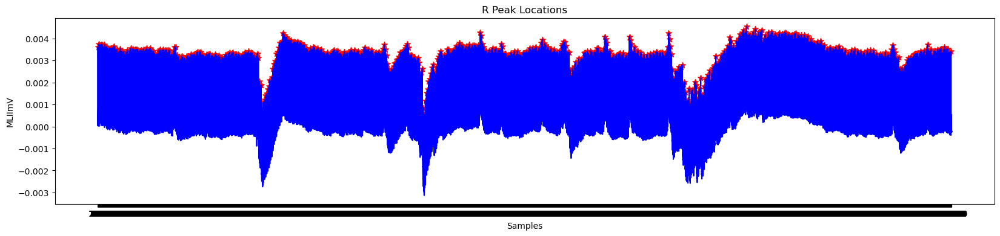

In [13]:
# Calculate the heart rate
heartRate = (60*fs)/np.average(rri)
print("R Peak detected:", len(r_peak), "beats")
print("Heart Rate",heartRate, "BPM")

# Plotting the R peak locations in ECG signal
plt.figure(figsize = (20,4), dpi = 100)
plt.xticks(np.arange(0, len(signal)+1, 150))
plt.plot(signal, color = 'blue')        
plt.scatter(result, signal[result], color = 'red', s = 50, marker= '*')
plt.xlabel('Samples')
plt.ylabel('MLIImV')
plt.title("R Peak Locations")

In [17]:
############################### Segment Grouping if we remove the very first R-Peak ###############################
#Segment in Samples
seg1 = trg1 - trg0 - r_peak[0]
seg2 = trg2 - trg0 - r_peak[0]
seg3 = trg3 - trg0 - r_peak[0]

#Segment in ms
newseg1 = int(seg1/fs)
newseg2 = int(seg2/fs)
newseg3 = int(seg3/fs)

exp_duration = (len(mne_ecg) - r_peak[0] - (len(mne_ecg) - r_peak[-1]))/fs  #Tot duration - First Peak - (Tot Duration - Last peak) 
############################### Segment Grouping if we remove the very first R-Peak ###############################

#### Data Interpolation and STFT

Text(0.5, 0, 'Time [sec]')

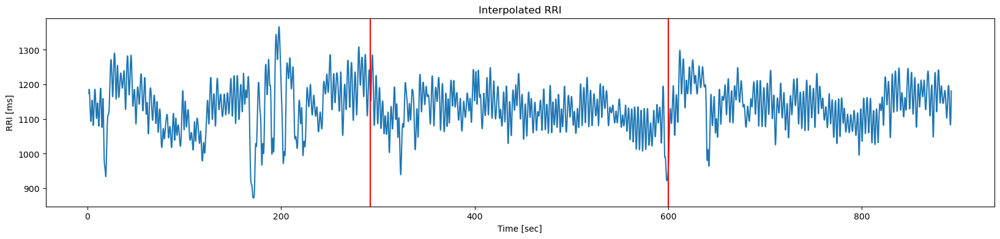

In [18]:
# #Data Interpolation, Fs = 1000
# exp_duration = len(mne_ecg)/fs

x_vals = np.linspace(r_peak[1],r_peak[-1],int(exp_duration*fs))
splines = scipy.interpolate.splrep(r_peak[1:],rri)
y_vals = scipy.interpolate.splev(x_vals,splines)

plt.figure(figsize = (20,4),dpi = 100)
plt.plot(x_vals/fs,y_vals)
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')

plt.title('Interpolated RRI')
plt.ylabel('RRI [ms]')
plt.xlabel('Time [sec]')

In [19]:
y_firstrest = y_vals[:seg1] 
y_stress = y_vals[seg1:seg2]
y_secondrest = y_vals[seg2:]

#### Time Analysis

In [17]:
#Measure SDNN
sdnn_full = np.std(y_vals)
sdnn_rest_1 = np.std(y_firstrest)
sdnn_test = np.std(y_stress)
sdnn_rest_2 = np.std(y_secondrest)
print("Standard Deviation during Experiment: ", sdnn_full)
print("Standard Deviation during First Rest: ", sdnn_rest_1)
print("Standard Deviation during CSWT: ", sdnn_test)
print("Standard Deviation during Second Rest: ", sdnn_rest_2)

Standard Deviation during Experiment:  64.8596415067019
Standard Deviation during First Rest:  81.76788981734185
Standard Deviation during CSWT:  53.01770412826808
Standard Deviation during Second Rest:  54.40276843842959


#### Frequency Analysis

##### PSD Measurement using Welch Method

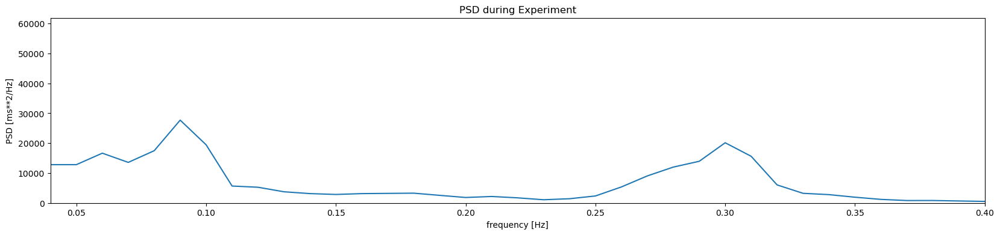

Absolute Power LF =  141141.70413258843 ms**2/Hz
Absolute Power HF =  119741.88508298763 ms**2/Hz
Total Power =  390748.6782886784 ms**2/Hz
LF/HF Ratio =  1.178716236467879
Normalized Power LF =  36.12083980699107 %
Normalized Power HF =  30.64422011800751 %


In [18]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_vals,fs,nperseg = nperseg, noverlap=noverlap)

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Experiment')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

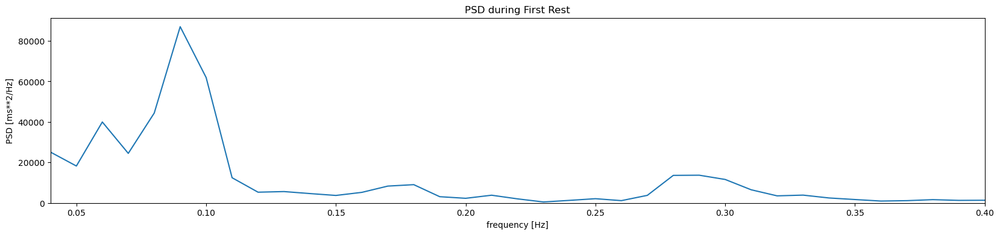

Absolute Power LF =  332812.48251346895 ms**2/Hz
Absolute Power HF =  109799.27892336562 ms**2/Hz
Total Power =  661126.2112026284 ms**2/Hz
LF/HF Ratio =  3.0310989814947265
Normalized Power LF =  50.34023411476349 %
Normalized Power HF =  16.607914958270086 %


In [19]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_firstrest,fs,nperseg = nperseg, noverlap=noverlap)

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during First Rest')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

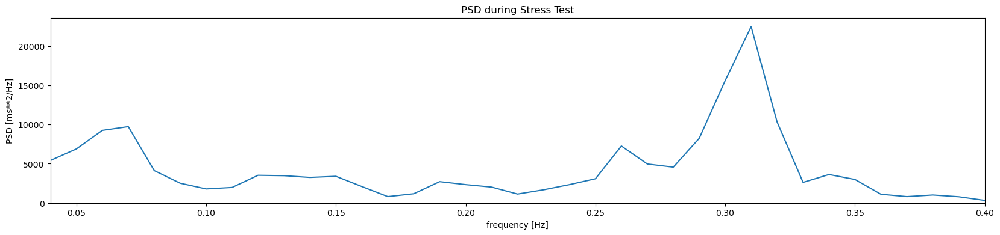

Absolute Power LF =  55411.91373134836 ms**2/Hz
Absolute Power HF =  109688.65825608763 ms**2/Hz
Total Power =  186956.64043503584 ms**2/Hz
LF/HF Ratio =  0.5051745058452572
Normalized Power LF =  29.638911783185918 %
Normalized Power HF =  58.67064042274686 %


In [20]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_stress,fs,nperseg = nperseg, noverlap=noverlap)
plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Stress Test')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

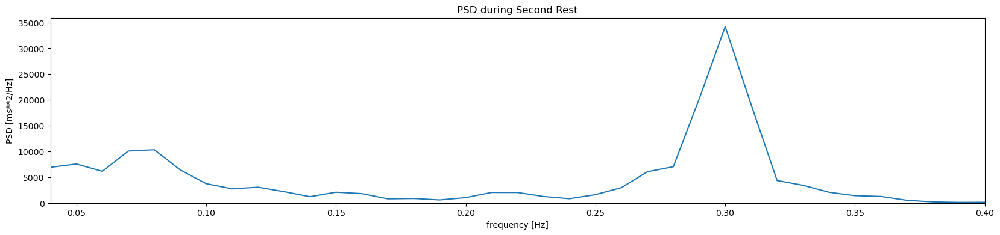

Absolute Power LF =  62531.865419354435 ms**2/Hz
Absolute Power HF =  118267.82772777084 ms**2/Hz
Total Power =  244898.98219956618 ms**2/Hz
LF/HF Ratio =  0.5287309881372847
Normalized Power LF =  25.533738383770714 %
Normalized Power HF =  48.29249458921612 %


In [21]:
nperseg = 100000
noverlap = nperseg*2/3

f_den, Pxx_den = sg.welch(y_secondrest,fs,nperseg = nperseg, noverlap=noverlap)
plt.figure(figsize = (20,4), dpi = 100)
plt.plot(f_den, Pxx_den)
plt.xlim(0.04, 0.4)
plt.ylim(bottom=0)
plt.title('PSD during Second Rest')
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [ms**2/Hz]')
plt.show()

idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))
idx_lfhf = np.where((0.04 <= f_den) & (f_den <= 0.40))
idx_tot_power = np.where((0 <= f_den) & (f_den <= 0.40))

abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
tot_power = np.sum(np.abs(Pxx_den[idx_tot_power]))

print('Absolute Power LF = ', abs_power_LF, 'ms**2/Hz')
print('Absolute Power HF = ',  abs_power_HF, 'ms**2/Hz')
print('Total Power = ', tot_power, 'ms**2/Hz' )

lf_hf_ratio = abs_power_LF/abs_power_HF
print('LF/HF Ratio = ', lf_hf_ratio)

norm_power_LF = (abs_power_LF/tot_power)*100
norm_power_HF = (abs_power_HF/tot_power)*100
print('Normalized Power LF = ', norm_power_LF, '%')
print('Normalized Power HF = ',  norm_power_HF, '%')

#### Time-Frequency Analysis

##### PSD Welch Over-time

In [22]:
# Parameters for segmentation and analysis
segment_length = 10*fs  # seconds
overlap = int(segment_length*0.9)  # seconds

# Calculate LF/HF ratio over time
lfhf_ratio = []
hf_over_time = []
lf_over_time = []

for i in range(0, len(y_vals), segment_length - overlap):
    segment = y_vals[i:i + segment_length]

    # Compute PSD using Welch's method
    f_den, Pxx_den = sg.welch(segment, fs=fs, nperseg = 10000)

    idx_lf = np.where((0.04 <= f_den) & (f_den <= 0.15))
    idx_hf = np.where((0.15 <= f_den) & (f_den <= 0.40))

    # Calculate LF and HF power
    abs_power_LF = np.sum(np.abs(Pxx_den[idx_lf]))
    abs_power_HF = np.sum(np.abs(Pxx_den[idx_hf]))
    lf_hf_ratio = abs_power_LF / abs_power_HF

    # Calculate LF/HF ratio
    if math.isnan(lf_hf_ratio) == False:
        lfhf_ratio.append(lf_hf_ratio)
    if math.isnan(abs_power_HF) == False:
        hf_over_time.append(abs_power_HF)
    if math.isnan(abs_power_LF) == False:
        lf_over_time.append(abs_power_LF)


c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 9109, using nperseg = 9109
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 8109, using nperseg = 8109
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 7109, using nperseg = 7109
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 6109, using nperseg = 6109
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-p

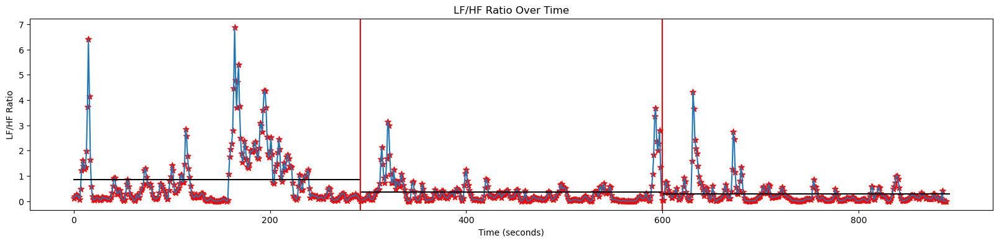

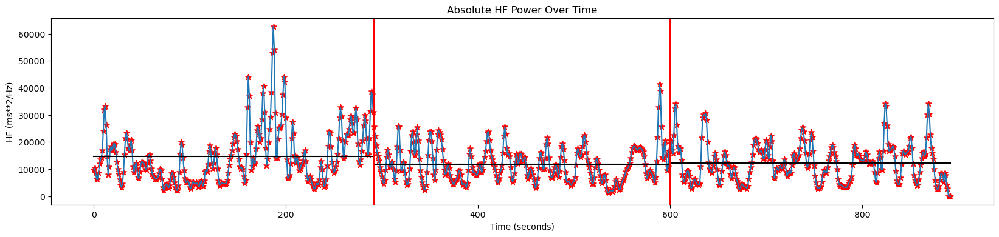

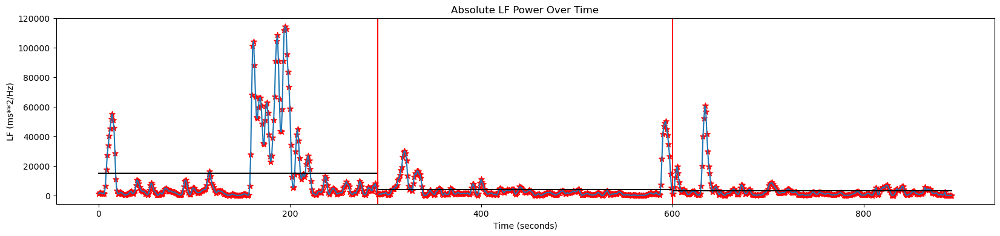

In [23]:
# Plot LF/HF ratio over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(lfhf_ratio)*(segment_length - overlap), segment_length - overlap)/fs, lfhf_ratio)
plt.plot((0, newseg1), (np.average(lfhf_ratio[0:newseg1]),np.average(lfhf_ratio[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(lfhf_ratio[newseg1:newseg2]),np.average(lfhf_ratio[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(lfhf_ratio[newseg2:]),np.average(lfhf_ratio[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(lfhf_ratio)*(segment_length - overlap), segment_length - overlap)/fs, lfhf_ratio, color = 'red', s = 50, marker= '*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('LF/HF Ratio')
plt.title('LF/HF Ratio Over Time')
plt.show()

# Plot HF over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(hf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, hf_over_time)
plt.plot((0, newseg1), (np.average(hf_over_time[0:newseg1]),np.average(hf_over_time[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(hf_over_time[newseg1:newseg2]),np.average(hf_over_time[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(hf_over_time[newseg2:]),np.average(hf_over_time[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(hf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, hf_over_time, color = 'red', s = 50, marker ='*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('HF (ms**2/Hz)')
plt.title('Absolute HF Power Over Time')
plt.show()

# Plot LF over time
plt.figure(figsize = (20,4))
plt.plot(np.arange(0, len(lf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, lf_over_time)
plt.plot((0, newseg1), (np.average(lf_over_time[0:newseg1]),np.average(lf_over_time[0:newseg1])), 'k-')
plt.plot((newseg1, newseg2), (np.average(lf_over_time[newseg1:newseg2]),np.average(lf_over_time[newseg1:newseg2])), 'k-')
plt.plot((newseg2, newseg3), (np.average(lf_over_time[newseg2:]),np.average(lf_over_time[newseg2:])), 'k-')
plt.scatter(np.arange(0, len(lf_over_time)*(segment_length - overlap), segment_length - overlap)/fs, lf_over_time, color = 'red', s = 50, marker ='*')
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.xlabel('Time (seconds)')
plt.ylabel('LF (ms**2/Hz)')
plt.title('Absolute LF Power Over Time')
plt.show()

##### STFT

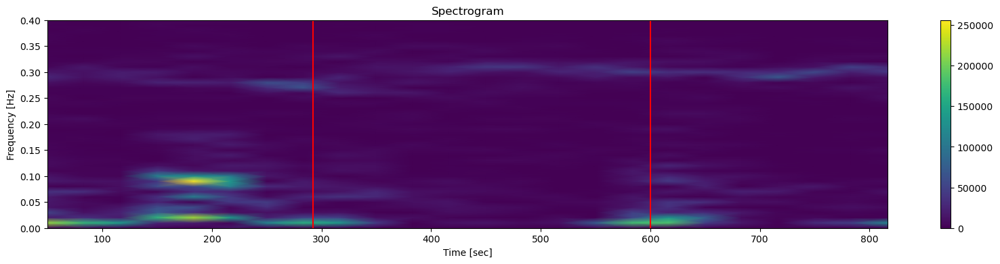

In [24]:
#STFT RRI
nperseg = 100000
noverlap = nperseg*2/3
f1,t1,Sxx = scipy.signal.spectrogram(y_vals, fs=fs, nperseg = nperseg, noverlap = noverlap, scaling='density')
plt.figure(figsize = (20,4), dpi = 100)
plt.pcolormesh(t1, f1, np.abs(Sxx), shading='gouraud', snap= True)
plt.title('Spectrogram')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.axis([t1[0], t1[-1], 0, 0.4])
plt.axvline(x = newseg1, color = 'r')
plt.axvline(x = newseg2, color = 'r')
plt.colorbar()
plt.show()

## EEG Analysis

In [93]:
raw_temp = raw.copy().crop(tmin = tmin, tmax = tmax) #make a copy
raw_temp.load_data()

Reading 0 ... 893088  =      0.000 ...   893.088 secs...


<RawBrainVision | 20240418_B98_jikken_0003.eeg, 67 x 893089 (893.1 s), ~456.6 MB, data loaded>

In [94]:
############################### Segment Grouping for EEG ###############################
#Segment in Samples
eeg_seg1 = trg1 - trg0
eeg_seg2 = trg2 - trg0
eeg_seg3 = trg3 - trg0

#Segment in ms
eeg_newseg1 = int(eeg_seg1/fs)
eeg_newseg2 = int(eeg_seg2/fs)
eeg_newseg3 = int(eeg_seg3/fs)
############################### Segment Grouping for EEG ###############################

### Preprocessing: ICA 

##### Visualizing Artifact

In [8]:
#Regular Expression = Search certain pattern
regexp = r"(ECG|vEOG|hEOG)"
artifact_picks = mne.pick_channels_regexp(raw_temp.ch_names, regexp=regexp)
# raw_temp.plot(order=artifact_picks, n_channels=len(artifact_picks), show_scrollbars=False)

Using EOG channels: vEOG, hEOG
EOG channel index for this subject is: [64 65]
Filtering the data to remove DC offset to help distinguish blinks from saccades
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Now detecting blinks and generating corresponding events
Found 50 significant peaks
Number of EOG events detected: 50
Not setting metadata
50 matching events found
No baseline correction applied
Loading data for 50 events and 1001 original time points ...
0 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dat

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


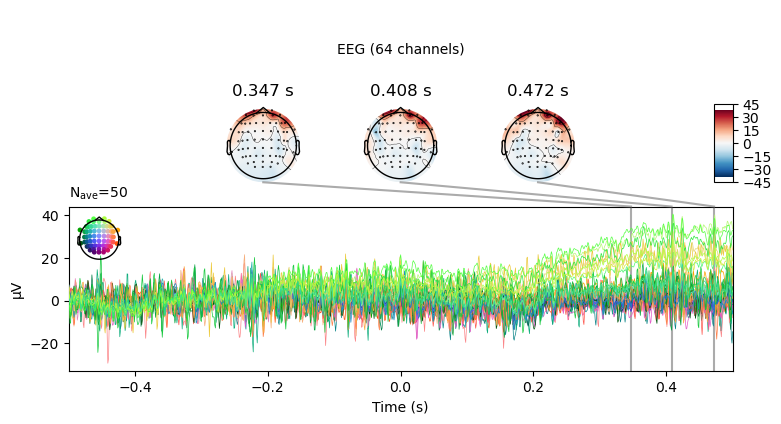

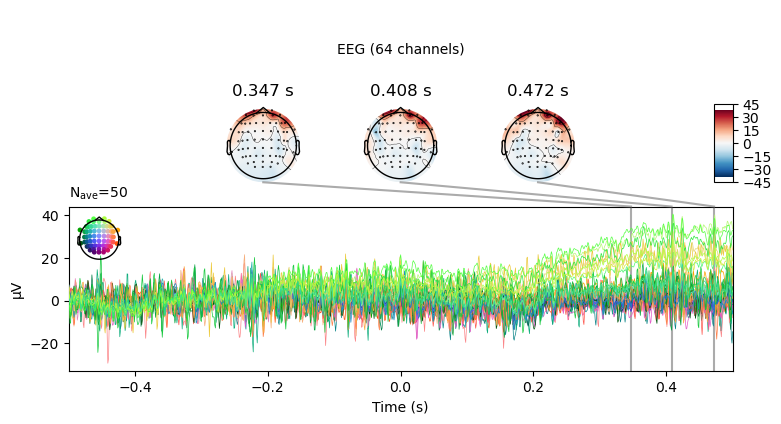

In [17]:
eog_evoked = create_eog_epochs(raw_temp).average()
eog_evoked.apply_baseline(baseline=(None, -0.2))
eog_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 sec)

Number of ECG events detected : 785 (average pulse 52 / min.)
Not setting metadata
785 matching events found
No baseline correction applied
Loading data for 785 events and 1001 original time points ...
1 bad epochs dropped
Applying baseline correction (mode: mean)
No projector specified for this dataset. Please consider the method self.add_proj.


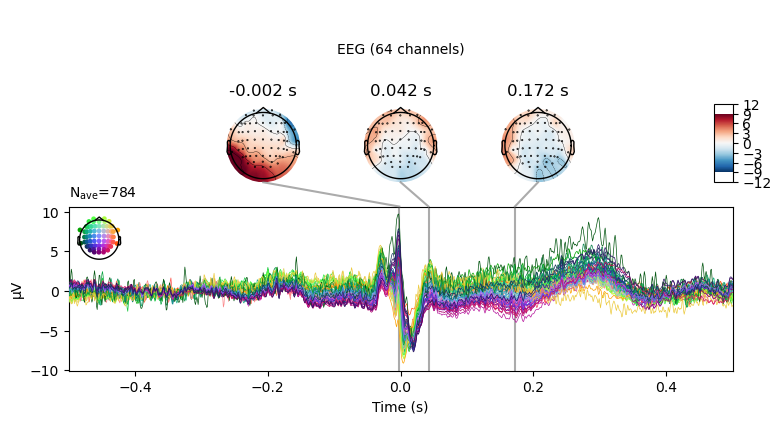

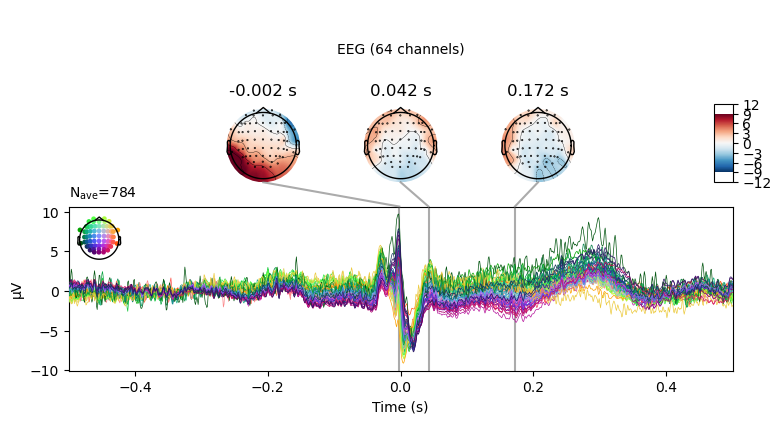

In [18]:
ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked.apply_baseline(baseline=(None, -0.2))
ecg_evoked.plot_joint()

##### Read ICA File

In [95]:
ica = read_ica("20240418_mat5mins/20240418_B98_jikken_0003-ica.fif")

Reading 20240418_mat5mins/20240418_B98_jikken_0003-ica.fif ...
Now restoring ICA solution ...
Ready.


Creating RawArray with float64 data, n_channels=35, n_times=893089
    Range : 33185 ... 926273 =     33.185 ...   926.273 secs
Ready.


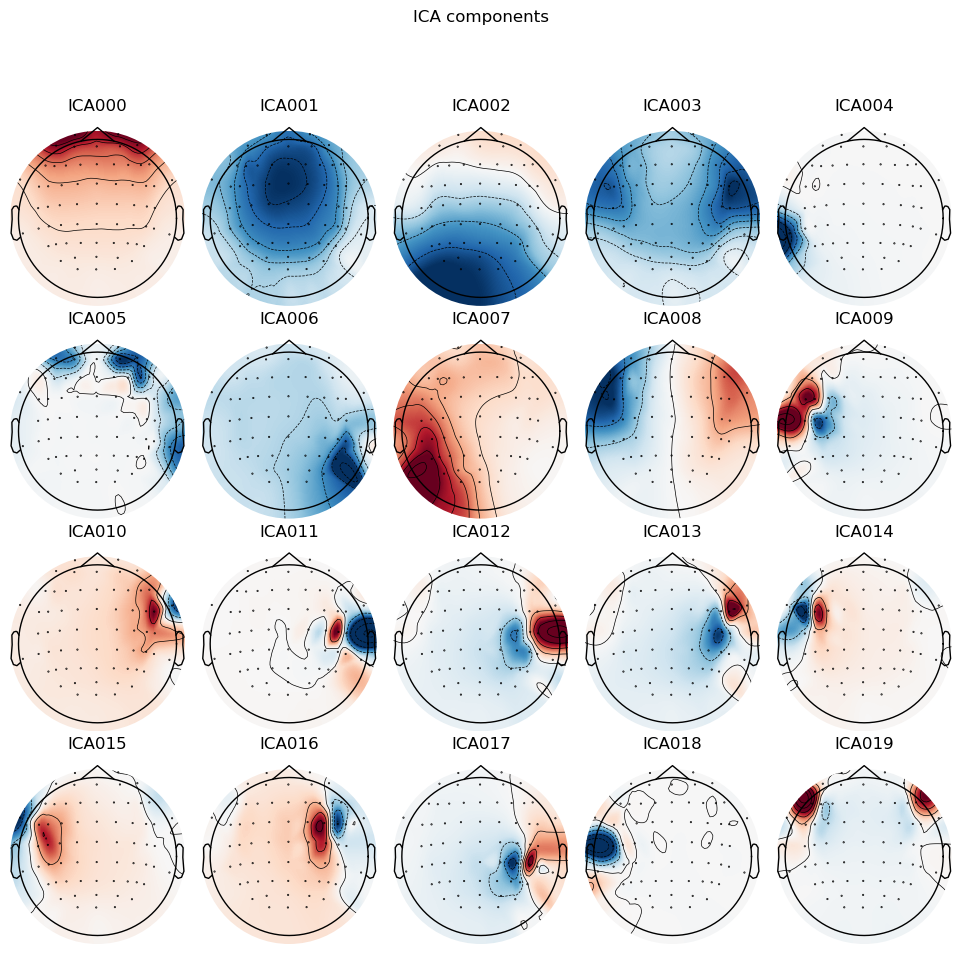

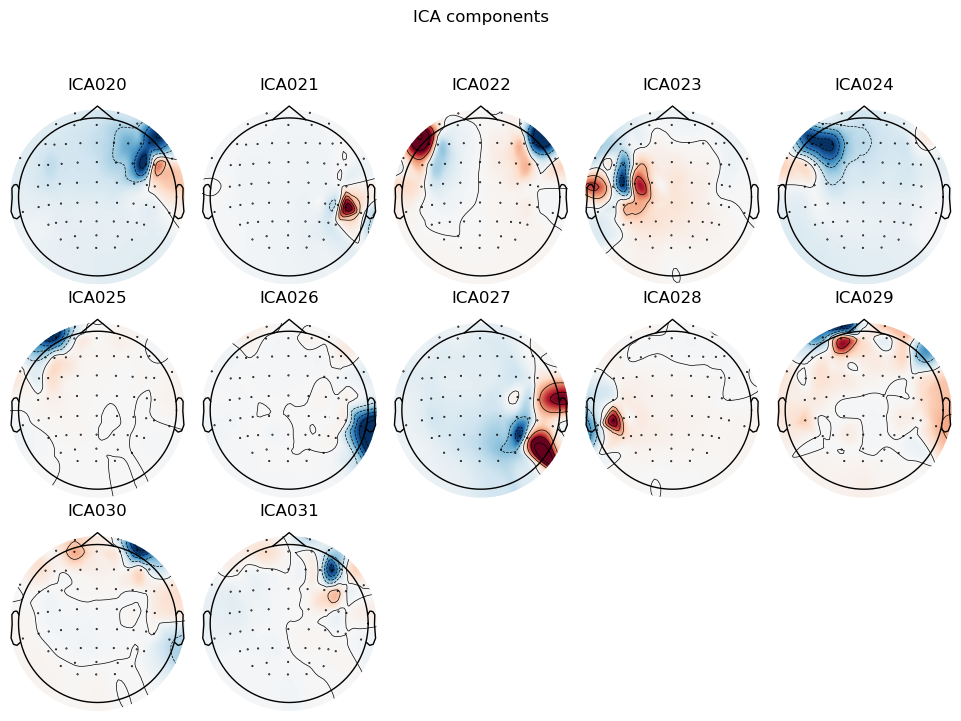

[<MNEFigure size 975x967 with 20 Axes>,
 <MNEFigure size 975x731.5 with 12 Axes>]

In [96]:
ica.plot_sources(raw_temp, show_scrollbars=False)
ica.plot_components()

##### Check Blinks PCA

Using EOG channels: vEOG, hEOG
... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)



[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.8s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)

... filtering ICA sources
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 s

[Parallel(n_jobs=1)]: Done  17 tasks      | elapsed:    0.8s


... filtering target
Setting up band-pass filter from 1 - 10 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 1.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 0.75 Hz)
- Upper passband edge: 10.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 10.25 Hz)
- Filter length: 10000 samples (10.000 s)

Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 1 ICA component
    Projecting back using 64 PCA components


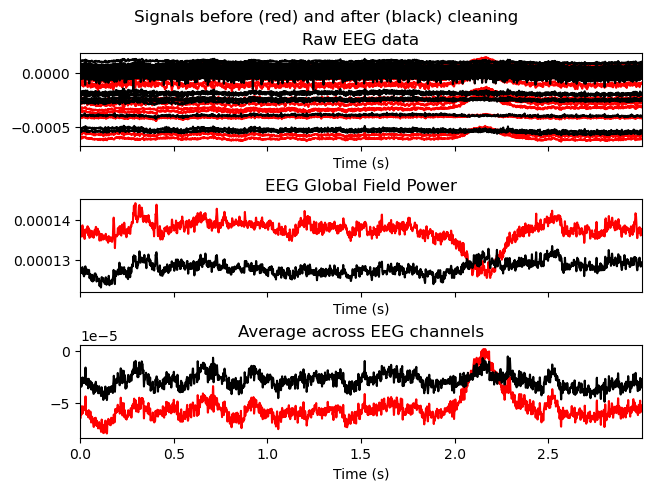

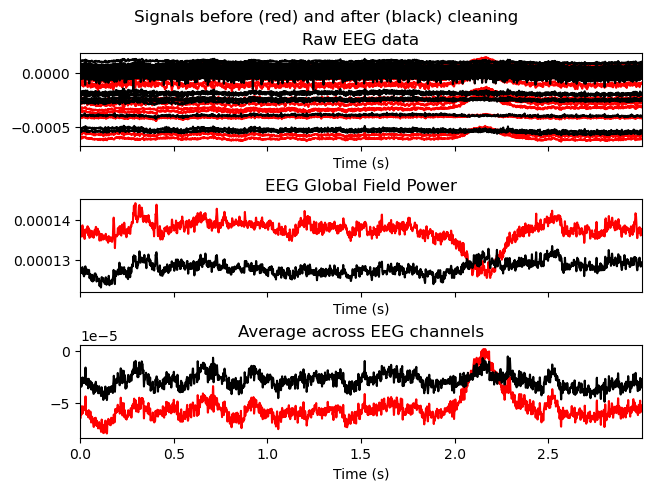

In [97]:
# Remove blinks PCA
eog_indices, eog_scores = ica.find_bads_eog(raw_temp, ch_name=['vEOG', 'hEOG'], threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=eog_indices, picks="eeg")
# ica.exclude = eog_indices

# ica.plot_properties(raw_temp, picks=eog_indices)
# ica.plot_scores(eog_scores)

##### Check ECG PCA

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 s)

Number of ECG events detected : 785 (average pulse 52 / min.)
Not setting metadata
785 matching events found
No baseline correction applied
Using data from preloaded Raw for 785 events and 1001 original time points ...
1 bad epochs dropped
Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 1 ICA component
    Projecting back using 64 PCA components


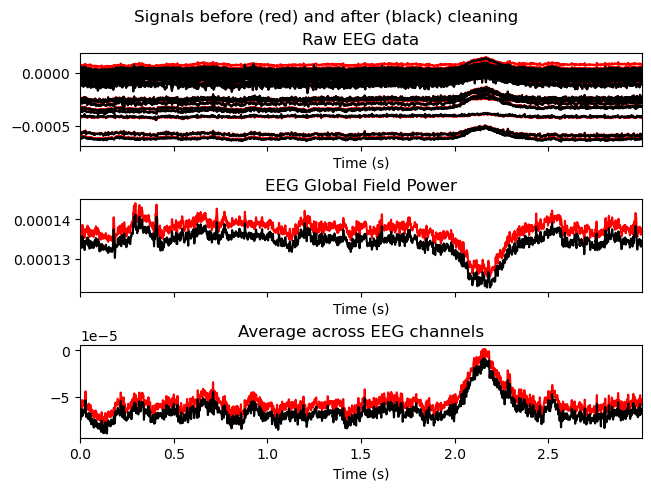

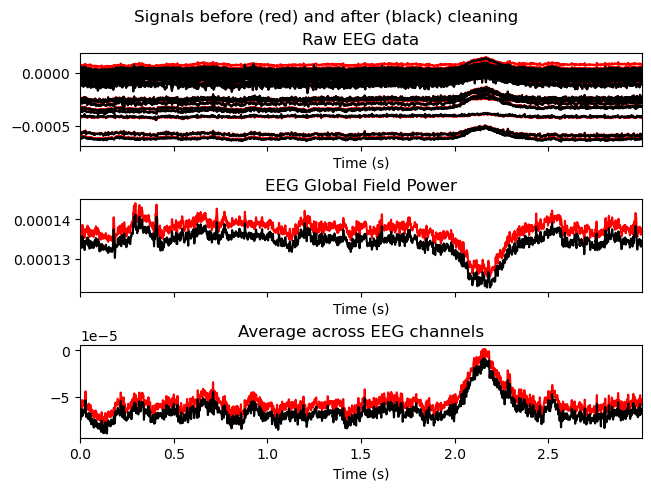

In [15]:
#Remove heart beat PCA
ecg_indices, ecg_scores = ica.find_bads_ecg(raw_temp, ch_name='ECG',threshold = 0.8, measure='correlation')
ica.plot_overlay(raw_temp, exclude=ecg_indices, picks="eeg")
#ica.exclude = ecg_indices

# ica.plot_properties(raw_temp, picks=ecg_indices)
# ica.plot_scores(ecg_scores)

##### Apply ICA

In [98]:
# ica.exclude = [0,1,5,6,7,8,9,10,11,12,14,15,19,20,21,23,25,27]
ica.exclude = eog_indices
#Prominent EOG artifact: 0
#Close to EOG: 
#Unknown: 
#Suspected Muscle: 

In [99]:
# ica.apply() changes the Raw object in-place, so let's make a copy first:
reconst_raw = raw_temp.copy()
ica.apply(reconst_raw)

Applying ICA to Raw instance
    Transforming to ICA space (32 components)
    Zeroing out 1 ICA component
    Projecting back using 64 PCA components


<RawBrainVision | 20240418_B98_jikken_0003.eeg, 67 x 893089 (893.1 s), ~456.6 MB, data loaded>

### After ICA EEG Analysis

In [13]:
# reconst_raw.copy().pick(['TP9','TP7','P7']).plot(title = 'Reconstructed')
# raw_temp.copy().pick(['TP9','TP7','P7']).plot(title = 'Raw')

reconst_raw.plot(title = 'Reconstructed')
raw_temp.plot(title = 'Raw')

Channels marked as bad:
none
Channels marked as bad:
none


In [100]:
#Split After ICA Data into each segments

ica_firstrest = reconst_raw.copy().crop(tmin = 0, tmax = eeg_newseg1)
ica_stress = reconst_raw.copy().crop(tmin = eeg_newseg1, tmax = eeg_newseg2)
ica_secondrest = reconst_raw.copy().crop(tmin = eeg_newseg2)

### Frequency Analysis

#### Plot Frequency Bands Activity

#### PSD Analysis on EEG

Effective window size : 2.048 (s)


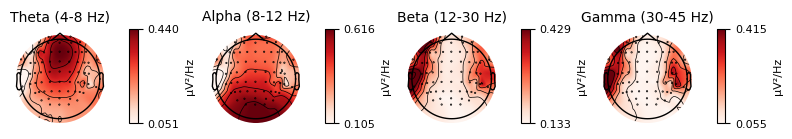

In [15]:
#### Full Experiment Plot
eeg_psd = reconst_raw.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 2.048 (s)


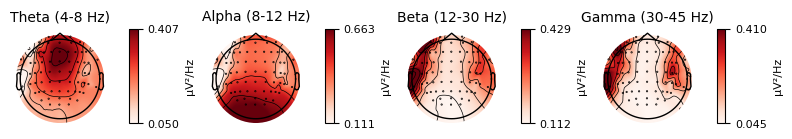

In [16]:
#### First Rest Plot
psd_firstrest = ica_firstrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 2.048 (s)


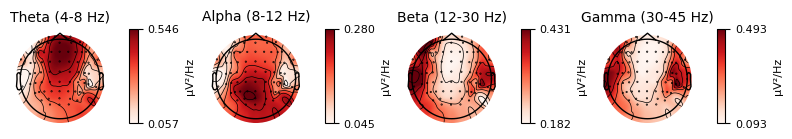

In [17]:
#### Stress Task Plot
psd_stress = ica_stress.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

Effective window size : 2.048 (s)


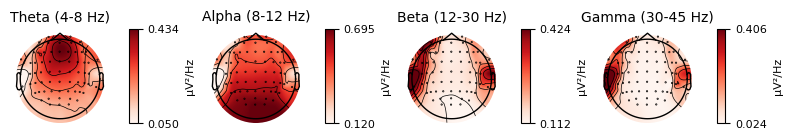

In [18]:
#### Second Rest Plot
psd_secondrest = ica_secondrest.compute_psd(method='welch',fmin=4,fmax=45).plot_topomap(bands = {'Theta (4-8 Hz)': (4, 8),'Alpha (8-12 Hz)': (8, 12), 'Beta (12-30 Hz)': (12, 30), 'Gamma (30-45 Hz)': (30, 45)}, normalize = True, ch_type='eeg')

### Time-Frequency Analysis

In [19]:
raw_eeg = reconst_raw.copy().pick_types(eeg=True, eog=False, ecg=False)
eeg_ch_names = raw_eeg.ch_names
eeg_data, _ = raw_eeg.get_data(picks = ['eeg'], return_times=True)

NOTE: pick_types() is a legacy function. New code should use inst.pick(...).


In [20]:
# Parameters for segmentation and analysis
segment_length = 10*fs  # seconds
overlap = int(segment_length*0.9)  # seconds

#### PSD Overtime Theta Band [4 - 8 Hz]

c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 9089, using nperseg = 9089
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 8089, using nperseg = 8089
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 7089, using nperseg = 7089
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\scipy\signal\_spectral_py.py:2017: UserWarning: nperseg = 10000 is greater than input length  = 6089, using nperseg = 6089
  warnings.warn('nperseg = {0:d} is greater than input length '
c:\Users\jeje_\anaconda3\envs\mne\Lib\site-p

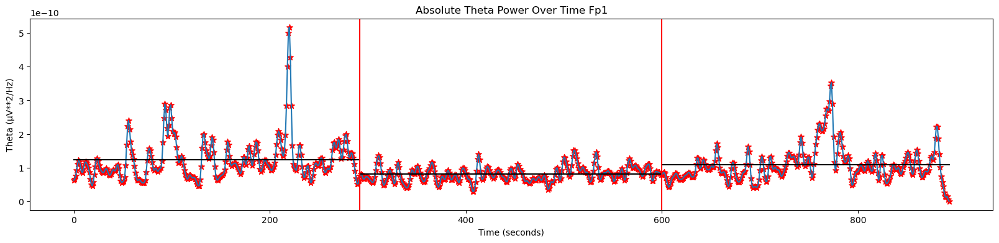

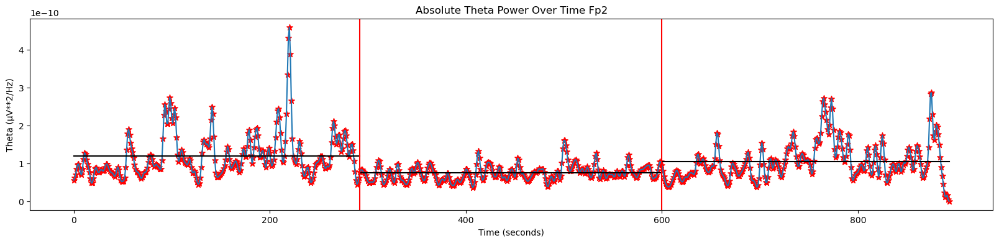

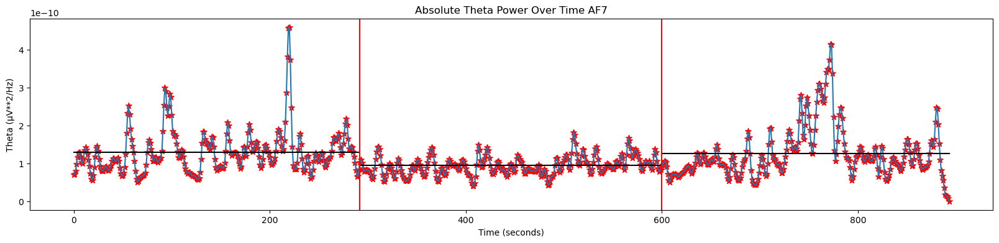

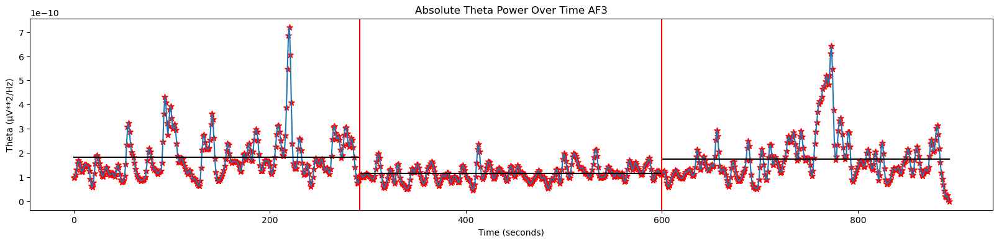

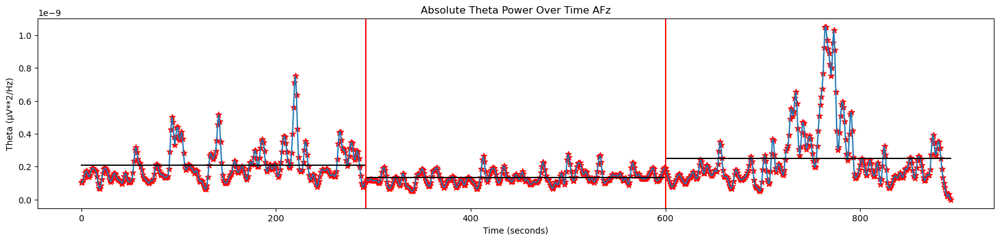

...

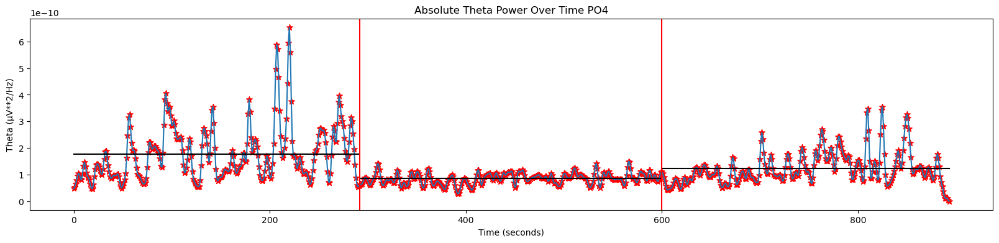

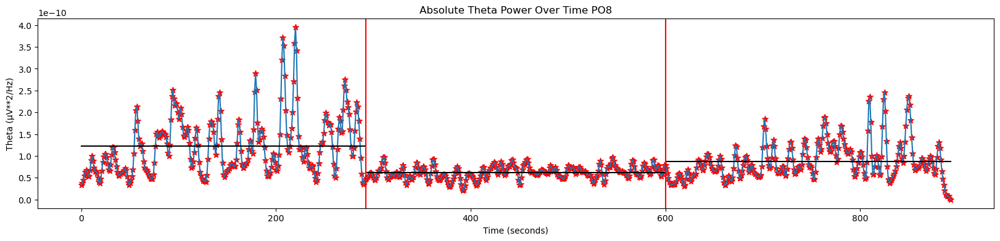

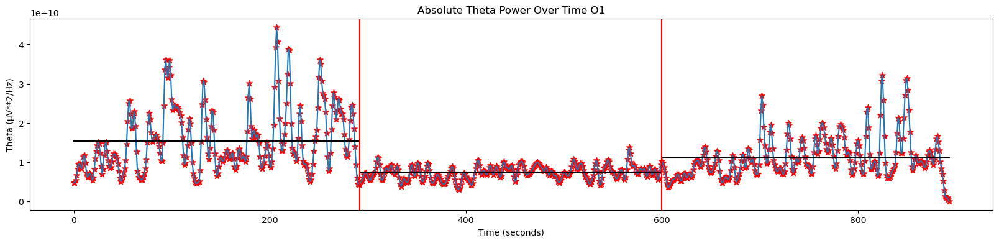

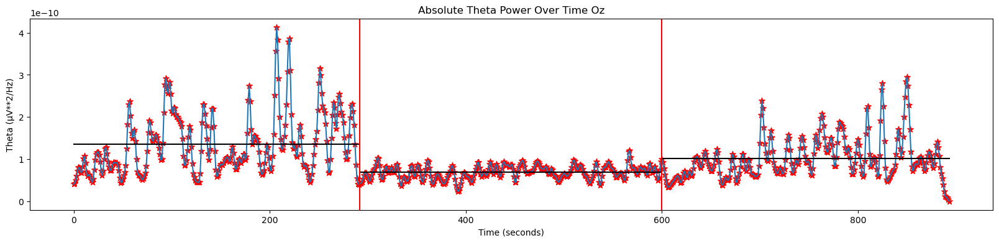

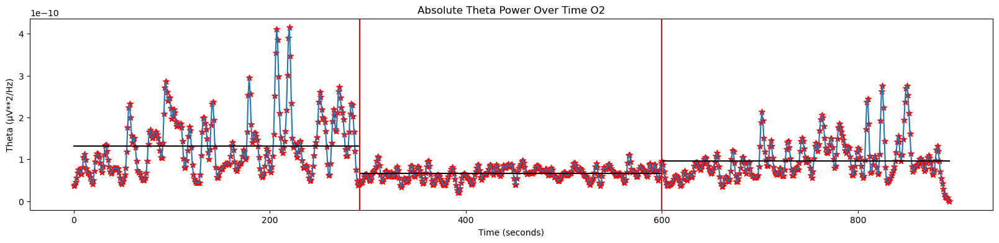

In [21]:
# Calculate Theta Band over time
theta_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    theta_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_theta = np.where((4 <= f_eeg) & (f_eeg <= 8))

        # Calculate Absolute Theta power
        abs_power_theta = np.sum(np.abs(Pxx_eeg[idx_theta]))

        # Append data
        if math.isnan(abs_power_theta) == False:
            theta_over_time.append(abs_power_theta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(theta_over_time[0:eeg_newseg1]),np.average(theta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(theta_over_time[eeg_newseg1:eeg_newseg2]),np.average(theta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(theta_over_time[eeg_newseg2:]),np.average(theta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(theta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, theta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Theta (μV**2/Hz)')
    plt.title('Absolute Theta Power Over Time '+ ch_name)
    plt.show()

    theta_row_data = {
        "ch_name": ch_name, 
        "power first rest" : theta_over_time[0:eeg_newseg1],
        "power stress" : theta_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : theta_over_time[eeg_newseg2:eeg_newseg3]
    }
    theta_data.append(theta_row_data)

#### PSD Overtime Alpha Band [8 - 12 Hz]

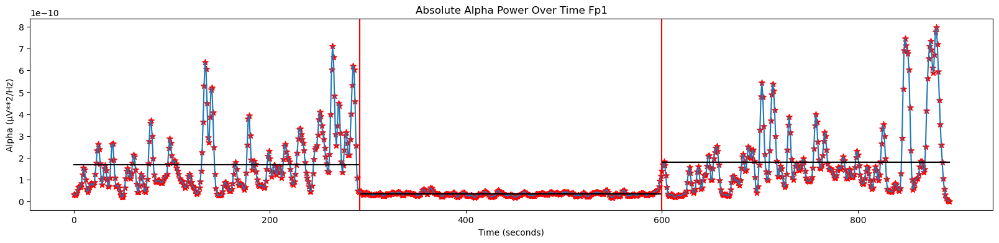

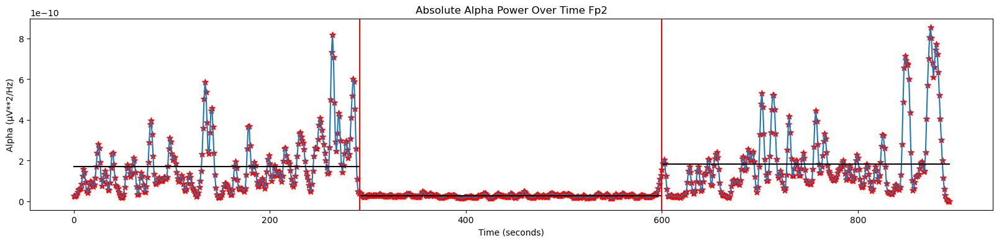

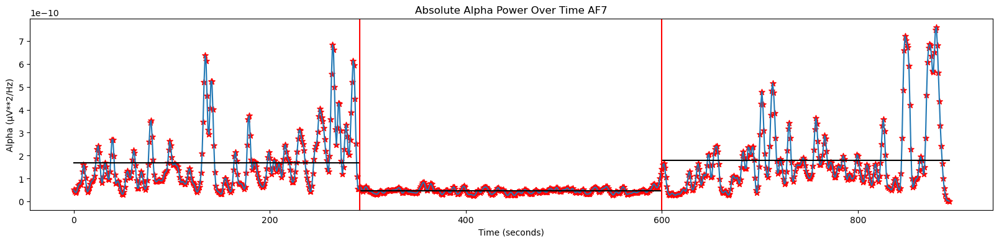

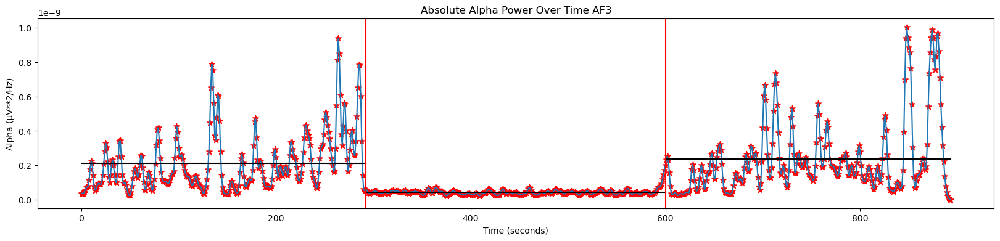

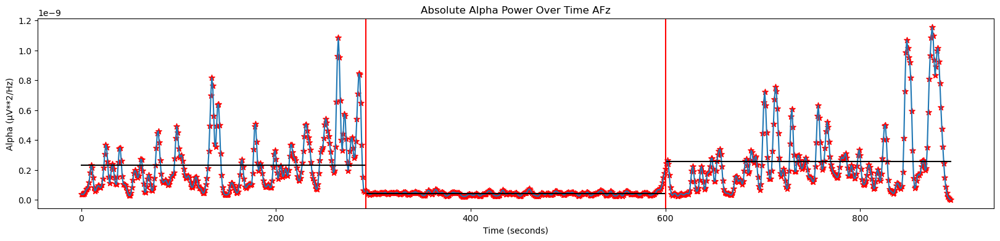

...

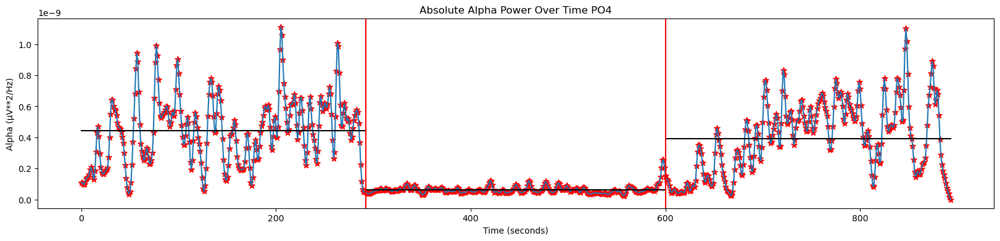

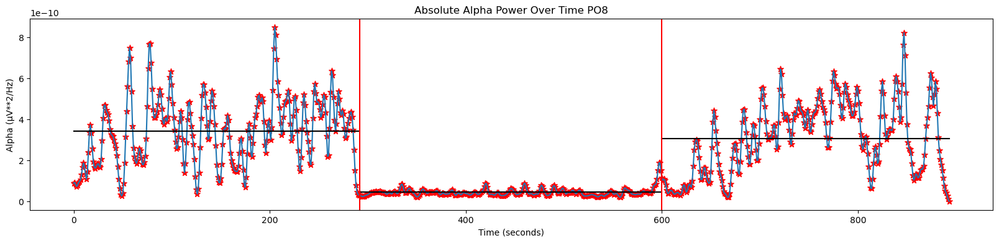

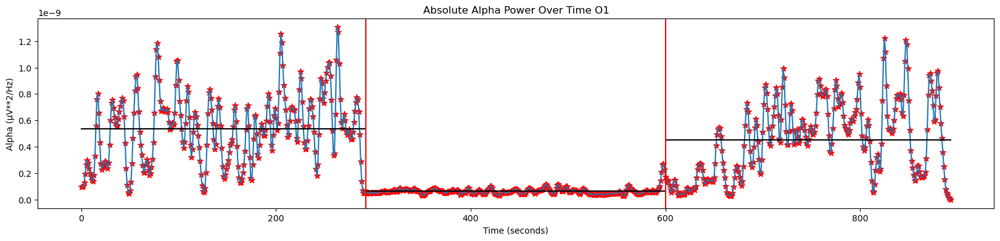

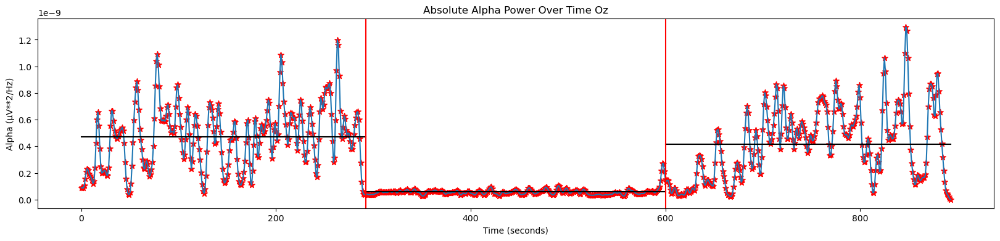

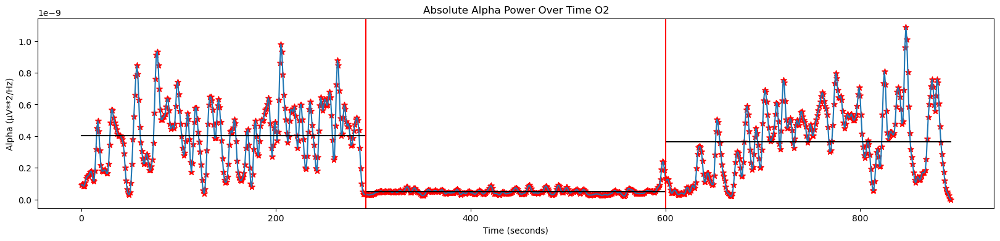

In [22]:
# Calculate Alpha Band over time
alpha_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    alpha_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_alpha = np.where((8 <= f_eeg) & (f_eeg <= 12))

        # Calculate Absolute Alpha power
        abs_power_alpha = np.sum(np.abs(Pxx_eeg[idx_alpha]))

        # Append data
        if math.isnan(abs_power_alpha) == False:
            alpha_over_time.append(abs_power_alpha)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time)
    plt.plot((0, eeg_newseg1), (np.average(alpha_over_time[0:eeg_newseg1]),np.average(alpha_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(alpha_over_time[eeg_newseg1:eeg_newseg2]),np.average(alpha_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(alpha_over_time[eeg_newseg2:]),np.average(alpha_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(alpha_over_time)*(segment_length - overlap), segment_length - overlap)/fs, alpha_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Alpha (μV**2/Hz)')
    plt.title('Absolute Alpha Power Over Time '+ ch_name)
    plt.show()
    
    alpha_row_data = {
        "ch_name": ch_name, 
        "power first rest" : alpha_over_time[0:eeg_newseg1],
        "power stress" : alpha_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : alpha_over_time[eeg_newseg2:eeg_newseg3]
    }
    alpha_data.append(alpha_row_data)

#### PSD Overtime Beta Band [12 - 30 Hz]

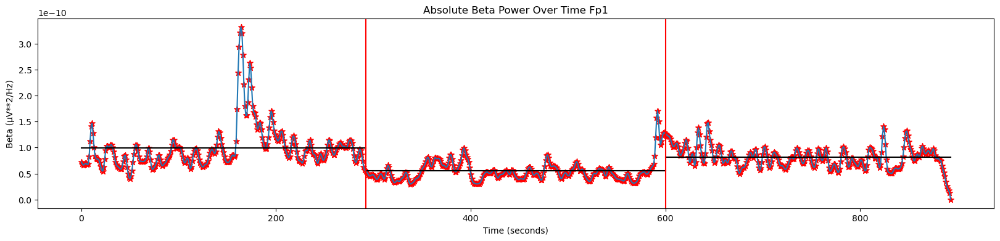

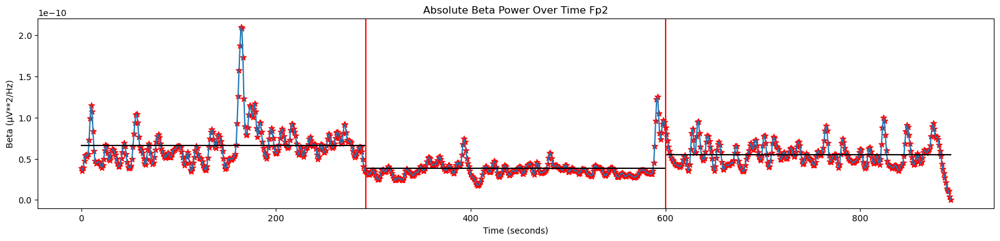

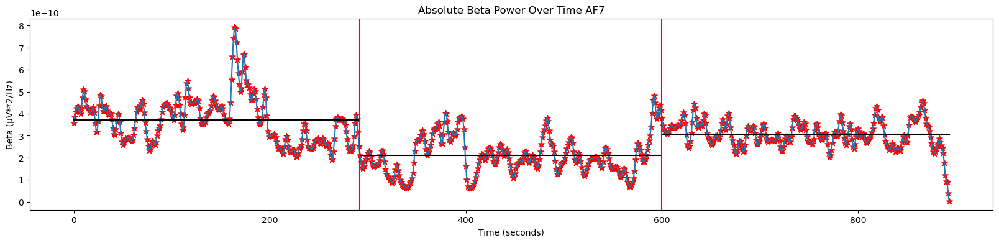

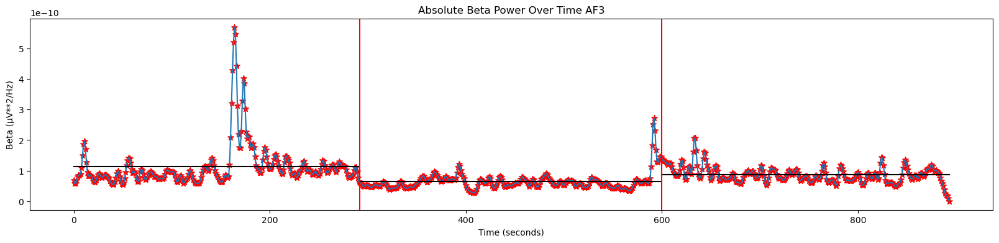

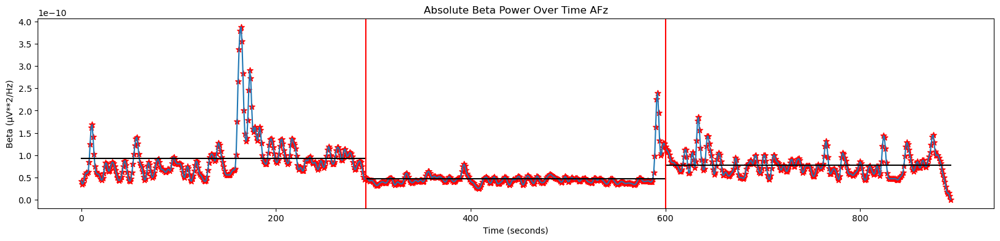

...

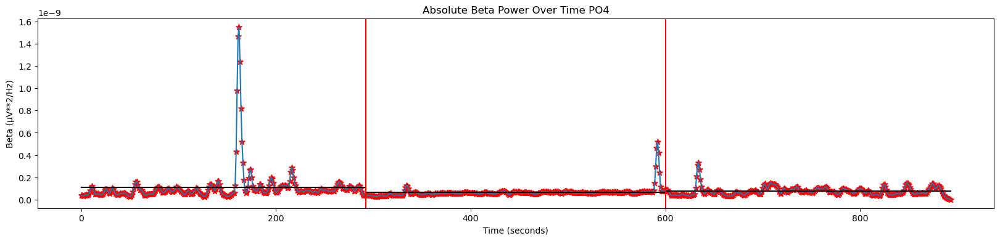

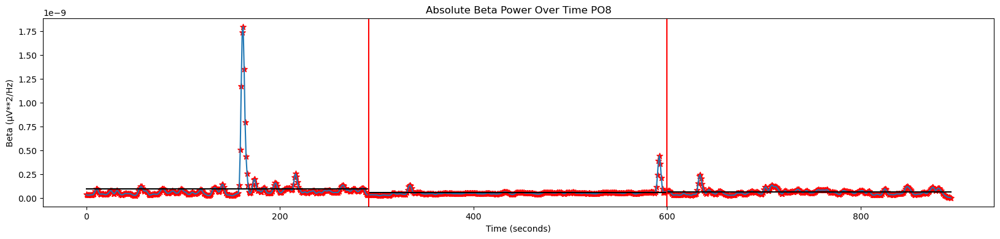

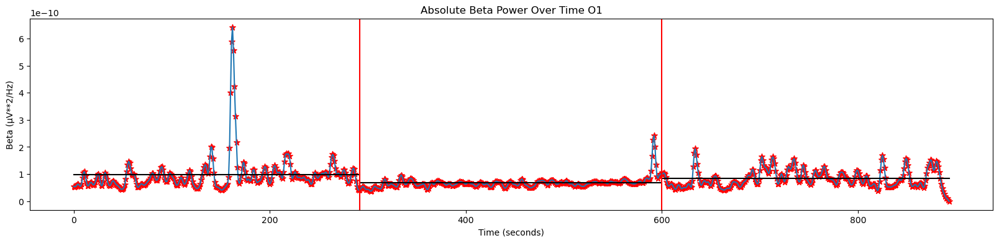

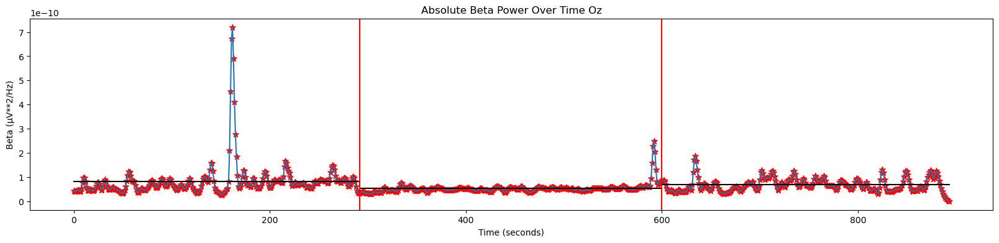

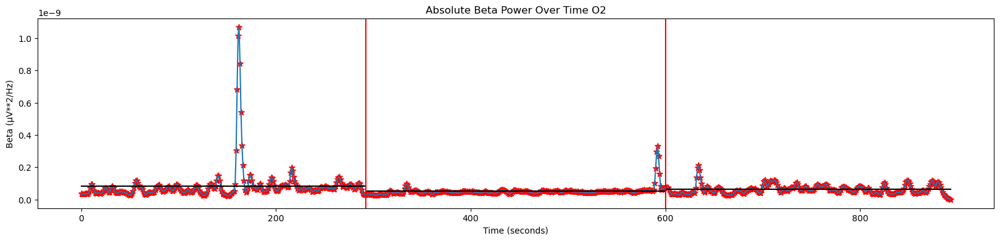

In [23]:
# Calculate Beta Band over time
beta_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    beta_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_beta = np.where((12 <= f_eeg) & (f_eeg <= 30))

        # Calculate Absolute Beta power
        abs_power_beta = np.sum(np.abs(Pxx_eeg[idx_beta]))

        # Append data
        if math.isnan(abs_power_beta) == False:
            beta_over_time.append(abs_power_beta)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time)
    plt.plot((0, eeg_newseg1), (np.average(beta_over_time[0:eeg_newseg1]),np.average(beta_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(beta_over_time[eeg_newseg1:eeg_newseg2]),np.average(beta_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(beta_over_time[eeg_newseg2:]),np.average(beta_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(beta_over_time)*(segment_length - overlap), segment_length - overlap)/fs, beta_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Beta (μV**2/Hz)')
    plt.title('Absolute Beta Power Over Time '+ ch_name)
    plt.show()

    beta_row_data = {
        "ch_name": ch_name, 
        "power first rest" : beta_over_time[0:eeg_newseg1],
        "power stress" : beta_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : beta_over_time[eeg_newseg2:eeg_newseg3]
    }
    beta_data.append(beta_row_data)

#### PSD Overtime Gamma Band [30 - 45 Hz]

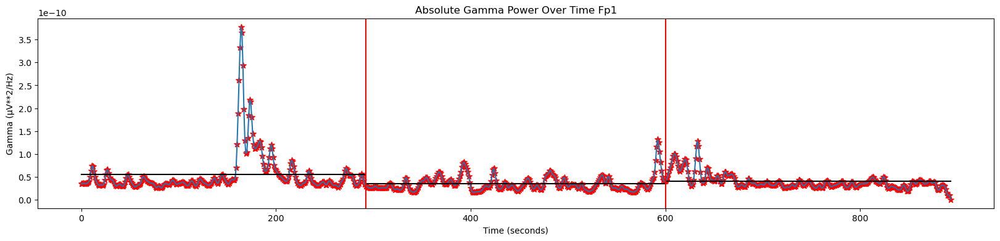

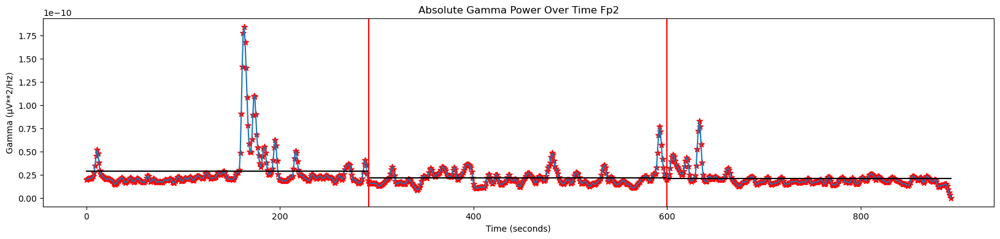

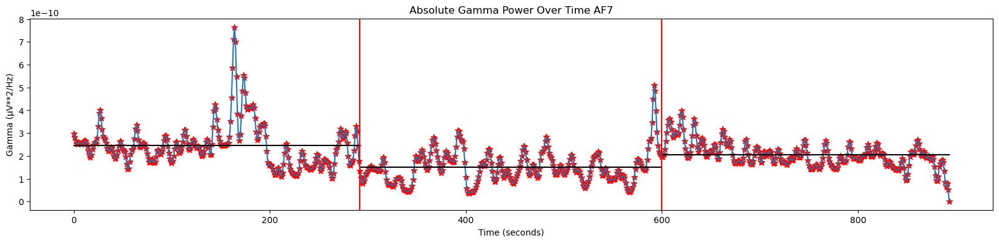

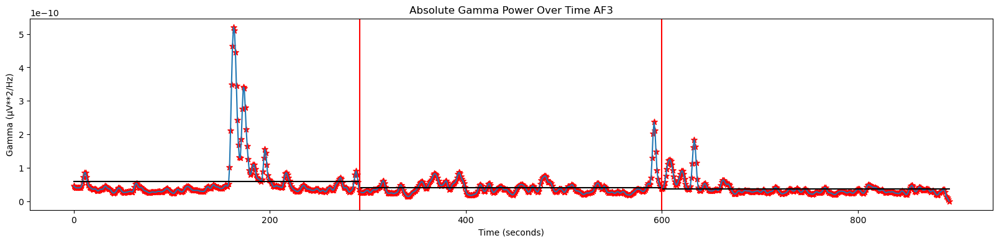

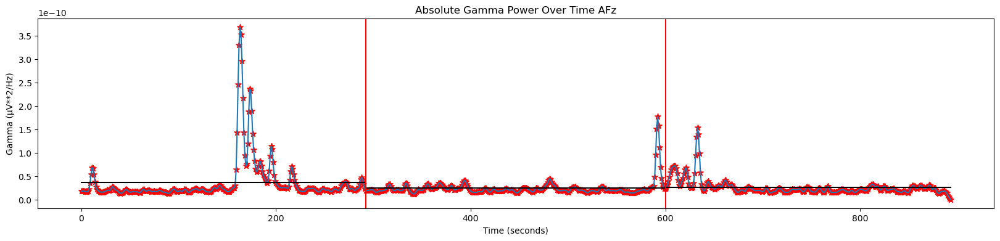

...

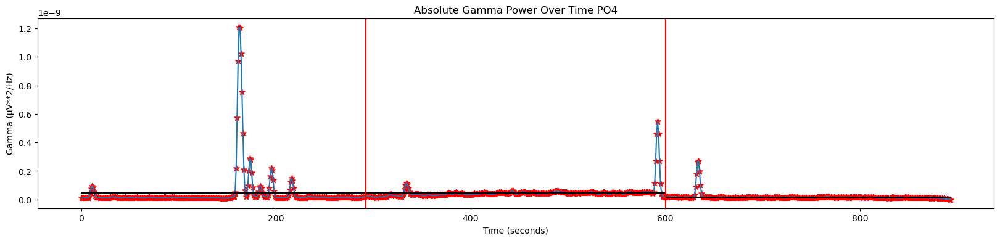

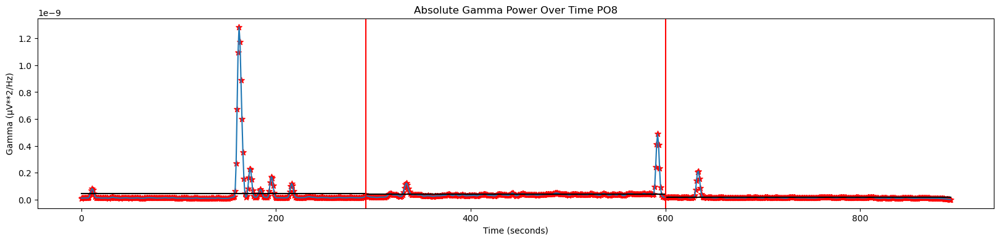

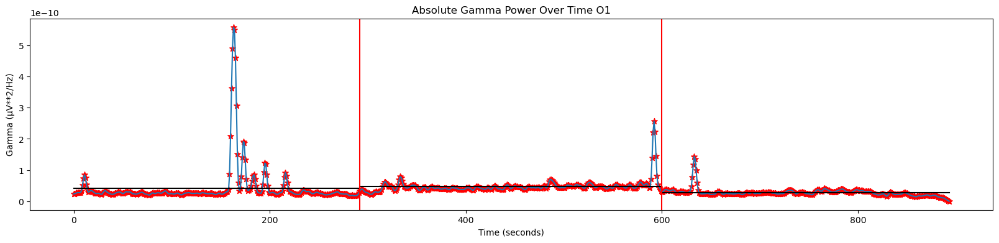

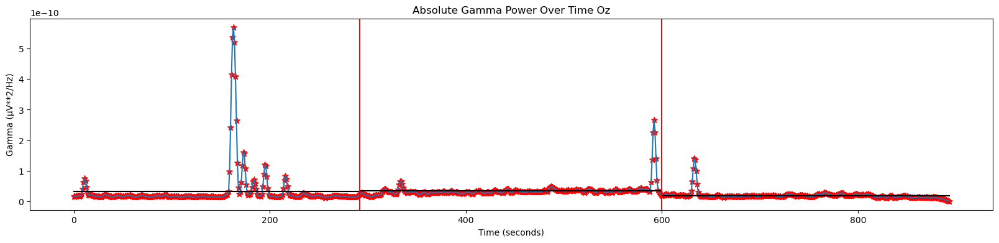

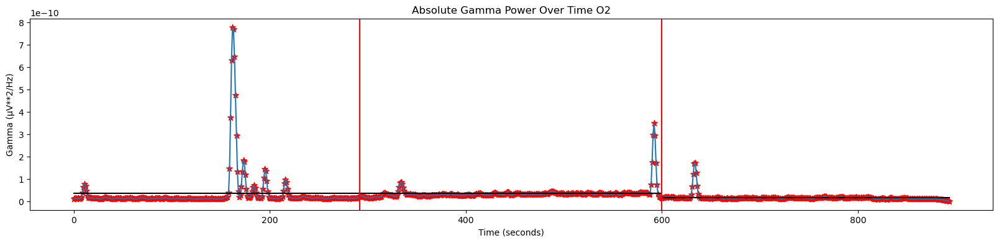

In [24]:
# Calculate Gamma Band over time
gamma_data =[]

for j in range(len(eeg_data)):
    node = eeg_data[j]
    ch_name = eeg_ch_names[j]
    gamma_over_time = []
    for i in range(0, len(node), segment_length - overlap):
        segment = node[i:i + segment_length]

        # Compute PSD using Welch's method
        f_eeg, Pxx_eeg = sg.welch(segment, fs=fs, nperseg = 10000)

        idx_gamma = np.where((30 <= f_eeg) & (f_eeg <= 45))

        # Calculate Absolute Gamma power
        abs_power_gamma = np.sum(np.abs(Pxx_eeg[idx_gamma]))

        # Append data
        if math.isnan(abs_power_gamma) == False:
            gamma_over_time.append(abs_power_gamma)
    
    plt.figure(figsize = (20,4))
    plt.plot(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time)
    plt.plot((0, eeg_newseg1), (np.average(gamma_over_time[0:eeg_newseg1]),np.average(gamma_over_time[0:eeg_newseg1])), 'k-')
    plt.plot((eeg_newseg1, eeg_newseg2), (np.average(gamma_over_time[eeg_newseg1:eeg_newseg2]),np.average(gamma_over_time[eeg_newseg1:eeg_newseg2])), 'k-')
    plt.plot((eeg_newseg2, eeg_newseg3), (np.average(gamma_over_time[eeg_newseg2:]),np.average(gamma_over_time[eeg_newseg2:])), 'k-')
    plt.scatter(np.arange(0, len(gamma_over_time)*(segment_length - overlap), segment_length - overlap)/fs, gamma_over_time, color = 'red', s = 50, marker ='*')
    plt.axvline(x = eeg_newseg1, color = 'r')
    plt.axvline(x = eeg_newseg2, color = 'r')
    plt.xlabel('Time (seconds)')
    plt.ylabel('Gamma (μV**2/Hz)')
    plt.title('Absolute Gamma Power Over Time '+ ch_name)
    plt.show()

    gamma_row_data = {
        "ch_name": ch_name, 
        "power first rest" : gamma_over_time[0:eeg_newseg1],
        "power stress" : gamma_over_time[eeg_newseg1:eeg_newseg2],
        "power second rest" : gamma_over_time[eeg_newseg2:eeg_newseg3]
    }
    gamma_data.append(gamma_row_data)

#### PSD Data to Data Frame and Array

In [25]:
theta_df = pd.DataFrame(theta_data)
display(theta_df)
# theta_array = np.array(theta_data)
# theta_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
theta_array = theta_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[6.236764273254448e-11, 6.583196598111572e-11,...","[7.497202069148153e-11, 8.126948298899045e-11,...","[7.930944141168266e-11, 8.327000622492586e-11,..."
1,Fp2,"[5.585652375288474e-11, 6.124445402991491e-11,...","[7.588859354037023e-11, 8.282647854268449e-11,...","[9.458499682448517e-11, 8.003955274654939e-11,..."
2,AF7,"[6.937998698549915e-11, 7.180470787809881e-11,...","[1.0300286409992818e-10, 1.0988733012842102e-1...","[8.888790931946463e-11, 9.629579605452394e-11,..."
3,AF3,"[9.825605078821798e-11, 9.982667792832598e-11,...","[1.0369280877701215e-10, 1.1023475052584225e-1...","[1.1248681675115797e-10, 1.2041877960581884e-1..."
4,AFz,"[1.0270366976345671e-10, 1.0632544175536644e-1...","[1.0899311006439853e-10, 1.179978117574877e-10...","[1.8831769834433068e-10, 1.7199672996866838e-1..."
...,...,...,...,...
59,PO4,"[4.727635638111255e-11, 5.2863459687028137e-11...","[6.084014012735769e-11, 6.235389048028589e-11,...","[1.1050251391242363e-10, 1.0358137706561622e-1..."
60,PO8,"[3.389303363367174e-11, 3.825793479308824e-11,...","[4.625573965774575e-11, 4.960815396820038e-11,...","[7.926149280116651e-11, 7.174448795266433e-11,..."
61,O1,"[4.695902736010398e-11, 4.669744283198594e-11,...","[4.5103836256390404e-11, 4.8123137622906014e-1...","[1.0191705402148342e-10, 9.781039128572882e-11..."
62,Oz,"[4.033128436987991e-11, 4.277573486725149e-11,...","[4.1867169078417046e-11, 4.298843626861915e-11...","[1.0045636947325173e-10, 9.192305323058e-11, 7..."


In [26]:
alpha_df = pd.DataFrame(alpha_data)
display(alpha_df)
# alpha_array = np.array(alpha_data)
# beta_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
alpha_array = alpha_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[3.244351567607295e-11, 2.9622272740320796e-11...","[4.683278619361912e-11, 4.401255797250232e-11,...","[1.4033159603716583e-10, 1.6714854361930902e-1..."
1,Fp2,"[2.605227297271295e-11, 2.5370535893901528e-11...","[4.2148746780466807e-11, 3.9366445865274844e-1...","[1.541594948737649e-10, 1.871937170231277e-10,..."
2,AF7,"[5.116662022713592e-11, 4.373518899279764e-11,...","[6.472746565056676e-11, 6.100467904543526e-11,...","[1.4107358209271808e-10, 1.5927817741285977e-1..."
3,AF3,"[3.8225167193522144e-11, 3.690401380478179e-11...","[5.967911637205566e-11, 5.8166600469348095e-11...","[2.0029531769284878e-10, 2.3398223705868487e-1..."
4,AFz,"[3.783347185424313e-11, 3.6133377634396206e-11...","[6.06645891283535e-11, 5.93996192579353e-11, 5...","[2.0732554574910909e-10, 2.4466662444891687e-1..."
...,...,...,...,...
59,PO4,"[1.0772264111437971e-10, 1.1013897983437762e-1...","[4.818397412576526e-11, 4.493184375389991e-11,...","[1.5222414195924462e-10, 1.29409362555901e-10,..."
60,PO8,"[8.839452874014818e-11, 9.15104088228202e-11, ...","[2.8609087278473773e-11, 2.6095326978917476e-1...","[1.14212577631837e-10, 1.0242873645568551e-10,..."
61,O1,"[9.635776135077737e-11, 9.877026500379151e-11,...","[5.238363105625735e-11, 5.450848978027815e-11,...","[1.7141376440073546e-10, 1.4693516996121182e-1..."
62,Oz,"[8.785108803546481e-11, 8.956876984716864e-11,...","[3.865009848528907e-11, 4.04013977903885e-11, ...","[1.5136827269904747e-10, 1.3402861792042579e-1..."


In [27]:
beta_df = pd.DataFrame(beta_data)
display(beta_df)
# beta_array = np.array(beta_data)
# beta_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
beta_array = beta_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[7.232999092705115e-11, 6.865240266082929e-11,...","[5.449148046041209e-11, 5.3670573976340724e-11...","[1.2691851348874163e-10, 1.2502379495439593e-1..."
1,Fp2,"[3.8504428696529574e-11, 3.579833076901579e-11...","[3.4492712719353293e-11, 3.418492576770307e-11...","[8.800835126638194e-11, 8.027799114036313e-11,..."
2,AF7,"[3.569410372872464e-10, 3.8469682426717484e-10...","[2.0962725123817655e-10, 1.7957144290848331e-1...","[3.7901496272597163e-10, 3.4679050479135194e-1..."
3,AF3,"[6.904924266705726e-11, 5.89306588694301e-11, ...","[6.135746023465777e-11, 5.971475246520618e-11,...","[1.39549785708843e-10, 1.3393273025433274e-10,..."
4,AFz,"[4.1730053613927265e-11, 3.518415101611474e-11...","[4.6732245280682506e-11, 4.858568656913206e-11...","[1.1885111515649005e-10, 1.132582131015643e-10..."
...,...,...,...,...
59,PO4,"[3.9738829400915766e-11, 3.482388129235647e-11...","[3.569085835735375e-11, 3.632247878341387e-11,...","[8.104270786295553e-11, 8.465498333326916e-11,..."
60,PO8,"[3.3799334126269313e-11, 3.003449891355544e-11...","[3.0460715304749484e-11, 3.140946470191208e-11...","[6.999578109307368e-11, 7.303838319837666e-11,..."
61,O1,"[5.423634299064951e-11, 5.322379450931027e-11,...","[4.23602821997149e-11, 4.706107285023817e-11, ...","[9.976135301176401e-11, 1.0181289753073172e-10..."
62,Oz,"[4.317802531775623e-11, 4.1283683833997956e-11...","[3.4034017156841945e-11, 3.6342448668136456e-1...","[8.280383236595923e-11, 8.47735975760149e-11, ..."


In [28]:
gamma_df = pd.DataFrame(gamma_data)
display(gamma_df)
# gamma_array = np.array(alpha_data)
# gamma_df.to_csv('20240418_mat5mins/out.csv', sep=',', index=False)  
gamma_array = gamma_df.to_numpy()

,ch_name,power first rest,power stress,power second rest
0,Fp1,"[3.509839781744983e-11, 3.5053284218322316e-11...","[3.001019010429151e-11, 2.9155783088915e-11, 2...","[4.036702735573141e-11, 4.25723696500367e-11, ..."
1,Fp2,"[1.987627481008437e-11, 2.0370648960322075e-11...","[1.5702822064622036e-11, 1.5560026707607507e-1...","[1.9599986398279646e-11, 2.136829090418872e-11..."
2,AF7,"[2.9767751393180713e-10, 2.8271077707882155e-1...","[1.3398986598794238e-10, 1.04690036226473e-10,...","[1.9838912251200156e-10, 1.9679749113407544e-1..."
3,AF3,"[4.535671588923028e-11, 4.30118771812637e-11, ...","[2.8129176062263953e-11, 2.6302590862798513e-1...","[3.596543058796009e-11, 3.790052222212953e-11,..."
4,AFz,"[1.777948669303886e-11, 1.815076438970416e-11,...","[1.925666368148469e-11, 1.8996301171670282e-11...","[2.330523017059122e-11, 2.5766246020607502e-11..."
...,...,...,...,...
59,PO4,"[1.0660536972920816e-11, 1.0990998725264988e-1...","[2.2937698610321343e-11, 2.537353949138016e-11...","[1.5099364759915603e-11, 1.5288878325245538e-1..."
60,PO8,"[1.018603043078648e-11, 1.0843342310181807e-11...","[2.3701442299727368e-11, 2.5776946544440355e-1...","[1.4901099517026046e-11, 1.4461165136667322e-1..."
61,O1,"[2.3207452648558655e-11, 2.4255433285805276e-1...","[3.277427336528983e-11, 3.7786029216453684e-11...","[2.969548992447049e-11, 2.979651183359664e-11,..."
62,Oz,"[1.5061378109395245e-11, 1.595646806095033e-11...","[2.3489761259481846e-11, 2.6703746022517013e-1...","[1.8147268874417857e-11, 1.8223137193557728e-1..."


## ERP: HEP

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 s)

Number of ECG events detected : 256 (average pulse 52 / min.)
Not setting metadata
256 matching events found
No baseline correction applied
Using data from preloaded Raw for 256 events and 1001 original time points ...
1 bad epochs dropped
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Applying baseline correction (mode: mean)
Need more than one channel to make topography for eeg. Disabling interactivity.


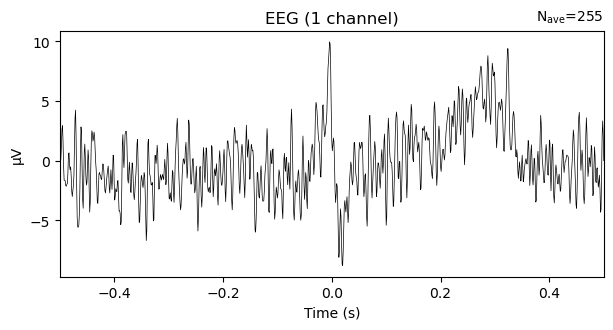

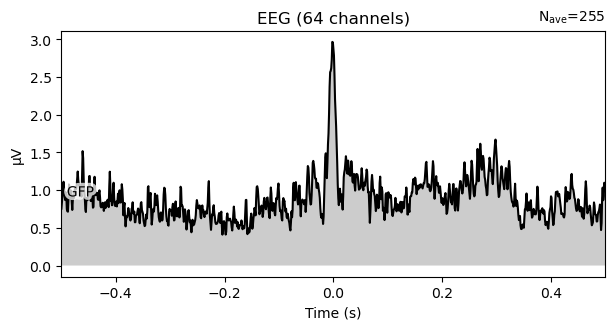

In [101]:
# ecg_evoked = create_ecg_epochs(raw_temp, picks=['AF7', 'F7', 'FT7','FT9','T7','TP9','TP7']).average()
# ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked_first_rest = create_ecg_epochs(ica_firstrest).average()
ecg_evoked_first_rest.apply_baseline(baseline=(None, None))
ecg_evoked_first_rest.plot(picks=['TP9'])
ecg_evoked_first_rest.plot(gfp='only',spatial_colors=True)
hev_data_first_rest = ecg_evoked_first_rest.get_data(picks=['TP9'])
hev_data_first_rest = hev_data_first_rest.T
# ecg_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 s)

Number of ECG events detected : 272 (average pulse 52 / min.)
Not setting metadata
272 matching events found
No baseline correction applied
Using data from preloaded Raw for 272 events and 1001 original time points ...
0 bad epochs dropped
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Applying baseline correction (mode: mean)
Need more than one channel to make topography for eeg. Disabling interactivity.


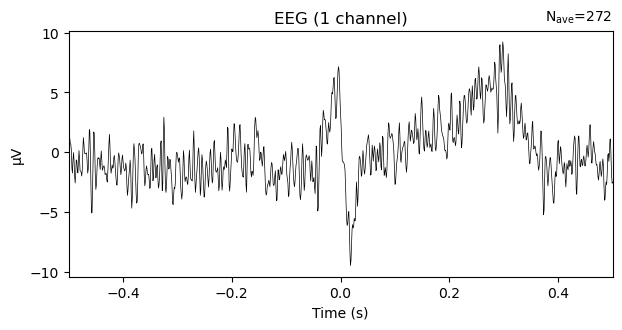

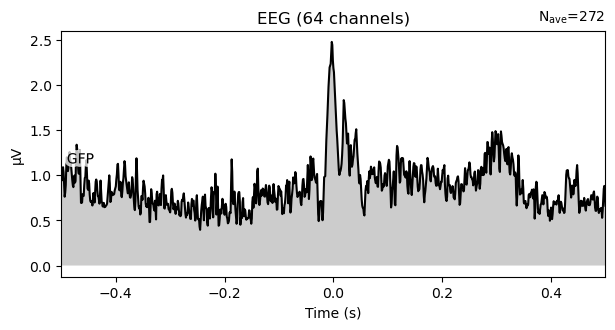

In [102]:
# ecg_evoked = create_ecg_epochs(raw_temp, picks=['AF7', 'F7', 'FT7','FT9','T7','TP9','TP7']).average()
# ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked_stress = create_ecg_epochs(ica_stress).average()
ecg_evoked_stress.apply_baseline(baseline=(None, None))
ecg_evoked_stress.plot(picks=['TP9'])
ecg_evoked_stress.plot(gfp='only',spatial_colors=True)
hev_data_stress = ecg_evoked_stress.get_data(picks=['TP9'])
hev_data_stress = hev_data_stress.T
# ecg_evoked.plot_joint()

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 s)

Number of ECG events detected : 255 (average pulse 52 / min.)
Not setting metadata
255 matching events found
No baseline correction applied
Using data from preloaded Raw for 255 events and 1001 original time points ...
0 bad epochs dropped
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Applying baseline correction (mode: mean)
Need more than one channel to make topography for eeg. Disabling interactivity.


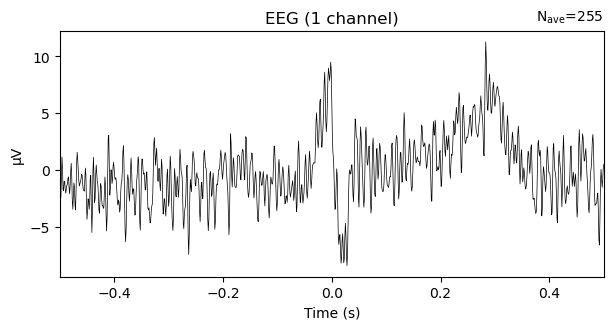

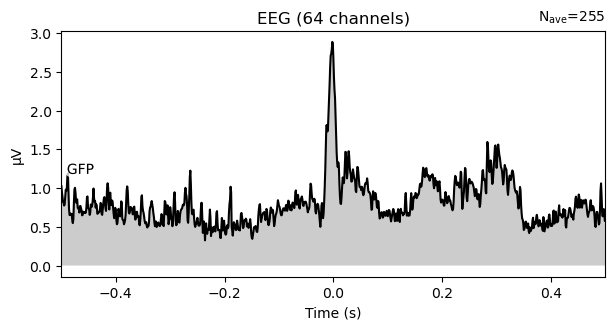

In [103]:
# ecg_evoked = create_ecg_epochs(raw_temp, picks=['AF7', 'F7', 'FT7','FT9','T7','TP9','TP7']).average()
# ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked_second_rest = create_ecg_epochs(ica_secondrest).average()
ecg_evoked_second_rest.apply_baseline(baseline=(None, None))
ecg_evoked_second_rest.plot(picks=['TP9'])
ecg_evoked_second_rest.plot(gfp='only',spatial_colors=True)
hev_data_second_rest = ecg_evoked_second_rest.get_data(picks=['TP9'])
hev_data_second_rest = hev_data_second_rest.T
# ecg_evoked.plot_joint()

combining channels using "gfp"
combining channels using "gfp"
combining channels using "gfp"


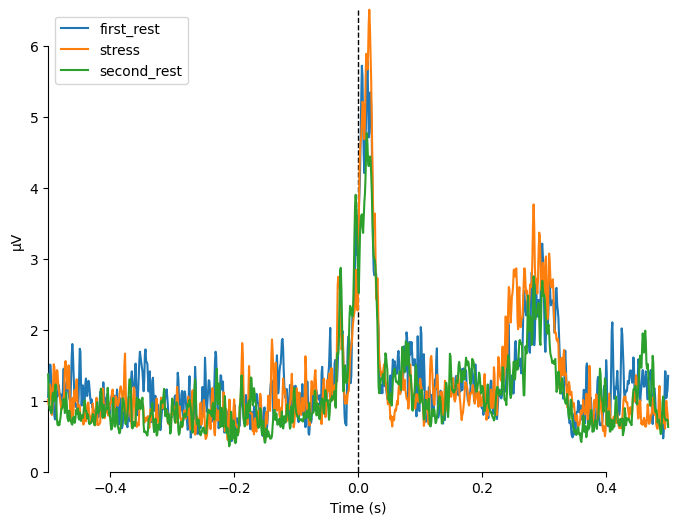

[<Figure size 800x600 with 1 Axes>]

In [107]:
evokeds = dict(first_rest = ecg_evoked_first_rest,stress = ecg_evoked_stress,second_rest = ecg_evoked_second_rest)
mne.viz.plot_compare_evokeds(evokeds,combine="gfp")

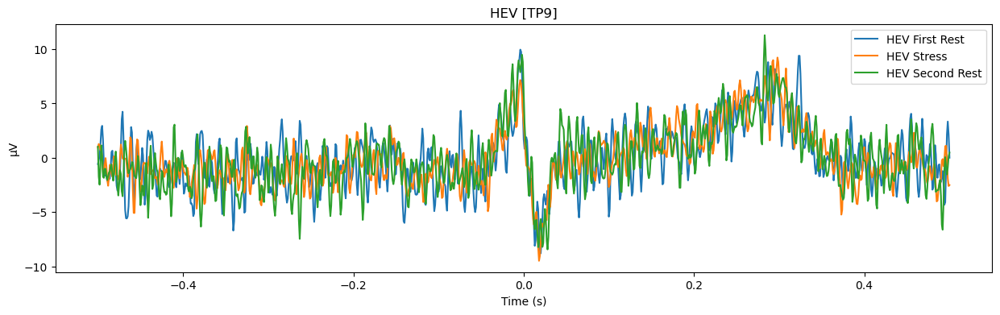

In [105]:
time_space = 1/fs
epoch_time = np.arange(-0.5, 0.5+time_space, time_space) 
plt.figure(figsize = (15,4))
plt.title(label='HEV [TP9]')
plt.plot(epoch_time,hev_data_first_rest * 1000000, label = 'HEV First Rest')
plt.plot(epoch_time,hev_data_stress* 1000000, label = 'HEV Stress')
plt.plot(epoch_time,hev_data_second_rest* 1000000, label = 'HEV Second Rest')
plt.ylabel('μV')
plt.xlabel('Time (s)')
plt.legend()
plt.show()

In [32]:
from mne import grand_average

Using channel ECG to identify heart beats.
Setting up band-pass filter from 8 - 16 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 8.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 7.75 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 16.25 Hz)
- Filter length: 10000 samples (10.000 s)

Number of ECG events detected : 785 (average pulse 52 / min.)
Not setting metadata
785 matching events found
No baseline correction applied
Using data from preloaded Raw for 785 events and 1001 original time points ...
1 bad epochs dropped
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
Applying baseline correction (mode: mean)
Need more than one channel to make topography for eeg. Disabling interactivity.


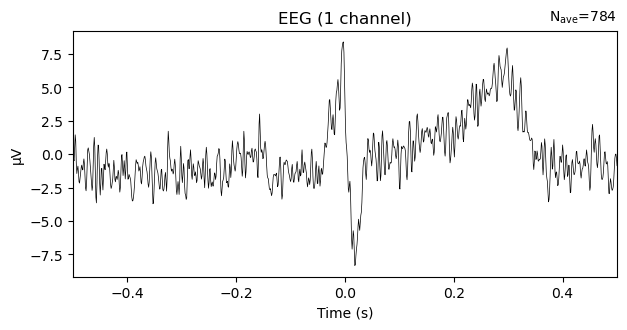

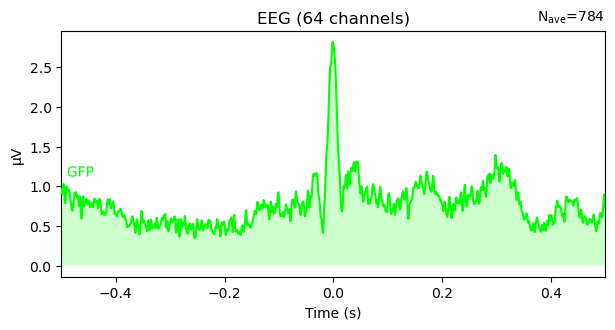

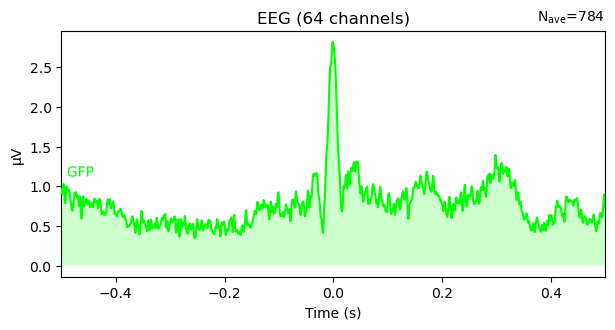

In [80]:
# ecg_evoked1 = create_ecg_epochs(ica_firstrest, picks=['AF7'])
# ecg_evoked2 = create_ecg_epochs(ica_firstrest, picks=['F7'])
# ecg_evoked3 = create_ecg_epochs(ica_firstrest, picks=['FT7'])
# ecg_evoked2 = create_ecg_epochs(ica_stress).average()
# ecg_evoked3 = create_ecg_epochs(ica_secondrest).average()

ecg_evoked = create_ecg_epochs(raw_temp).average()
ecg_evoked.apply_baseline(baseline=(None, None))
ecg_evoked.plot(picks = ['TP9'])
ecg_evoked.plot(gfp="only")


In [60]:
evoked = ecg_evoked

array(['Fp1', 'Fp2', 'AF7', 'AF3', 'AFz', 'AF4', 'AF8', 'F7', 'F5', 'F3',
       'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT9', 'FT7', 'FC5', 'FC3',
       'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'FT8', 'FT10', 'T7', 'C5', 'C3',
       'C1', 'Cz', 'C2', 'C4', 'C6', 'T8', 'TP9', 'TP7', 'CP5', 'CP3',
       'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'TP8', 'TP10', 'P7', 'P5', 'P3',
       'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'PO3', 'POz', 'PO4',
       'PO8', 'O1', 'Oz', 'O2'], dtype='<U4')

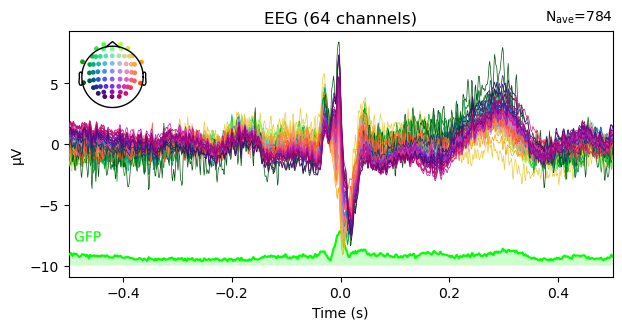

ValueError: too many values to unpack (expected 2)

In [76]:
evoked.plot(gfp=True)

all_evoked = mne.channels.combine_channels(evoked, groups = np.array(eeg_ch_names).T, method = 'mean')

In [51]:
evoked1 = ecg_evoked1.average()
evoked2 = ecg_evoked2.average()
evoked3 = ecg_evoked3.average()

NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).
NOTE: pick_channels() is a legacy function. New code should use inst.pick(...).


In [36]:
ga_first_rest = grand_average(ecg_evoked1)
ga_stress = grand_average(ecg_evoked2)
ga_second_rest = grand_average(ecg_evoked3)

TypeError: object of type 'EvokedArray' has no len()

## Other

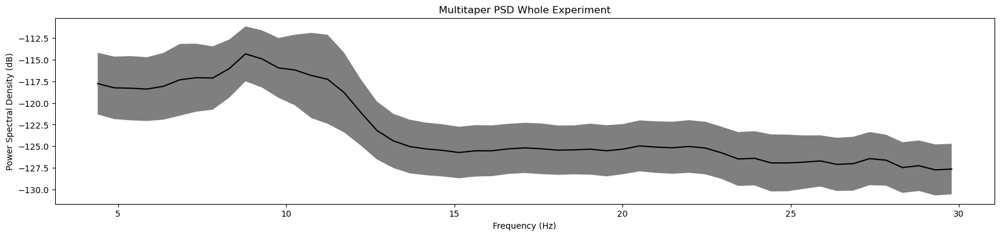

In [ ]:
psds, freqs = eeg_psd.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Whole Experiment")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

Effective window size : 100.000 (s)


c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\mne\viz\utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


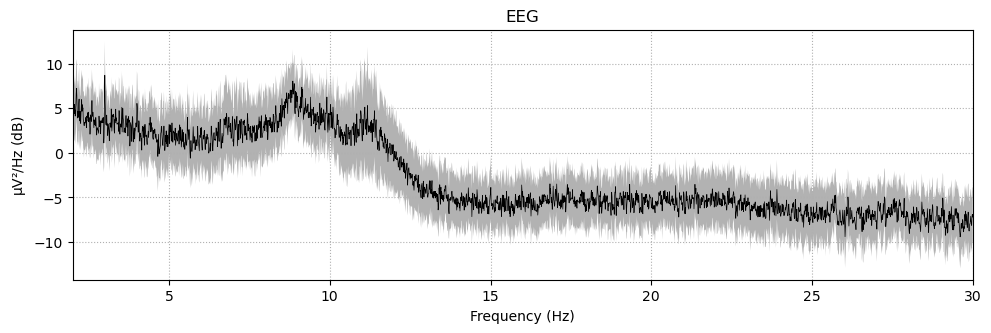

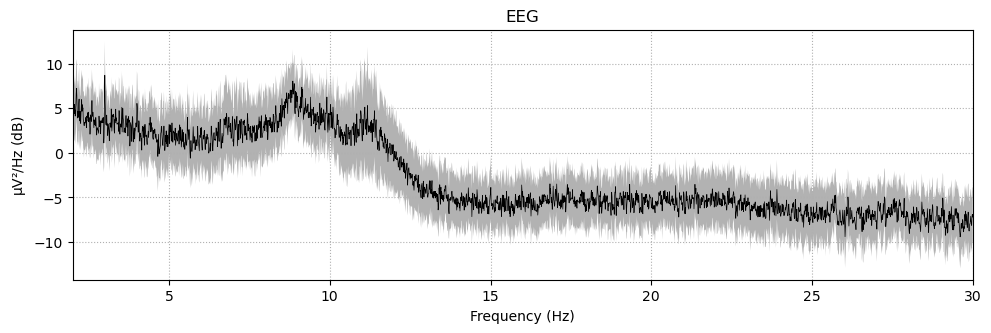

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
reconst_raw.compute_psd(method ='welch',fmin= 2.0, fmax = 30, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

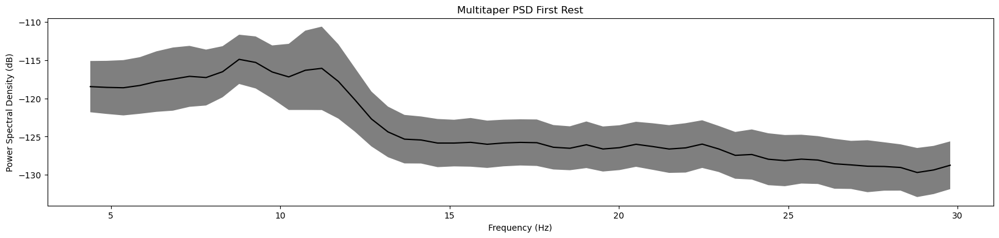

In [ ]:
psds, freqs = psd_firstrest.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD First Rest")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
# del(psds,psds_mean,psds_std, freqs)

Effective window size : 100.000 (s)


c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\mne\viz\utils.py:137: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


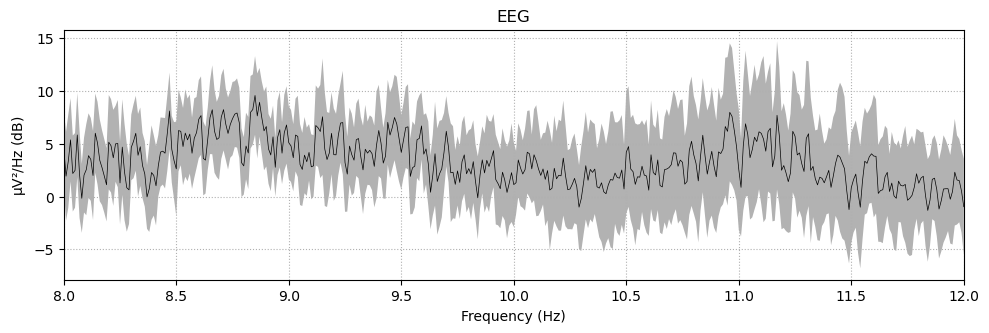

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
ica_firstrest.compute_psd(method ='welch',fmin= 8.0, fmax = 12, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

Effective window size : 100.000 (s)


c:\Users\Jeremi\anaconda3\envs\mne\lib\site-packages\mne\viz\utils.py:137: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  (fig or plt).show(**kwargs)


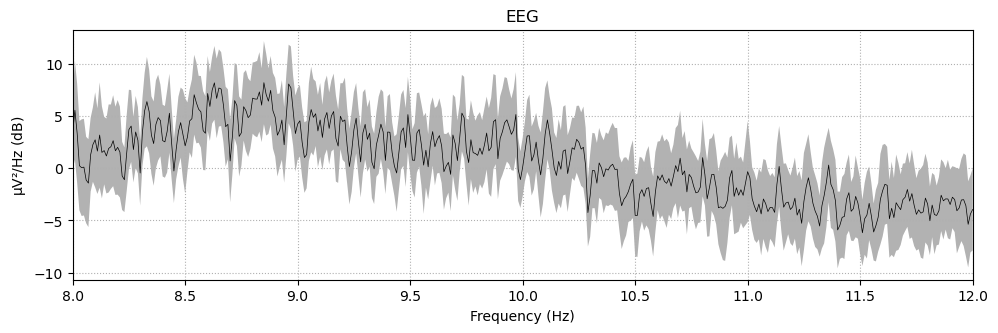

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
ica_stress.compute_psd(method ='welch',fmin= 8.0, fmax = 12, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

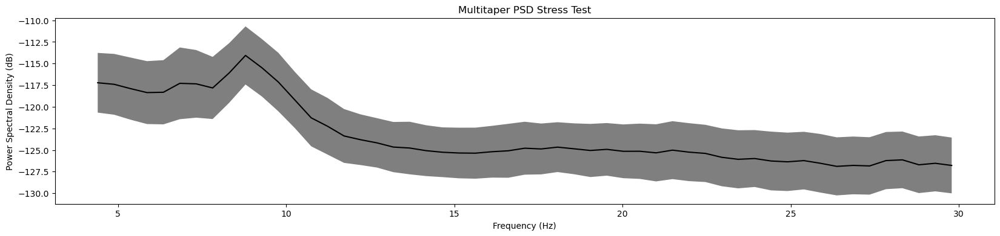

In [ ]:
psds, freqs = psd_stress.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Stress Test")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)

Effective window size : 100.000 (s)


c:\Users\jeje_\anaconda3\envs\mne\Lib\site-packages\mne\viz\utils.py:161: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


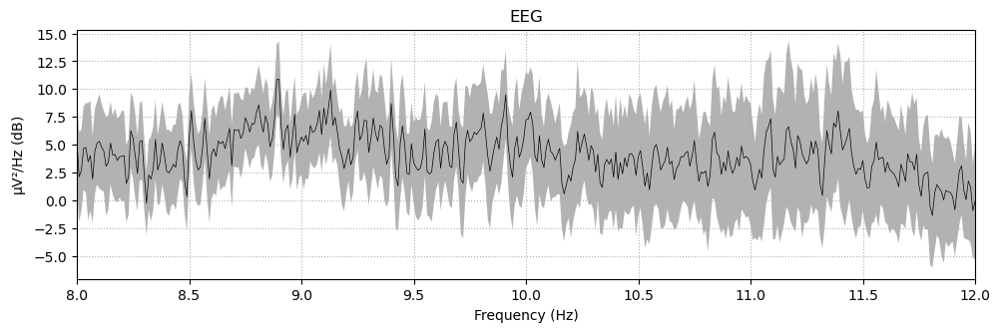

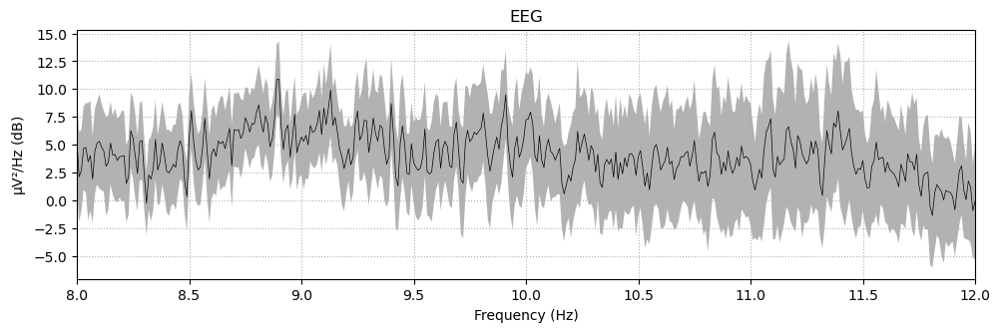

In [ ]:
nperseg = 100000
noverlap = int(nperseg*2/3)
ica_secondrest.compute_psd(method ='welch',fmin= 8.0, fmax = 12, n_fft = nperseg, n_overlap = noverlap, n_per_seg = nperseg).plot(average = True, picks = 'eeg')

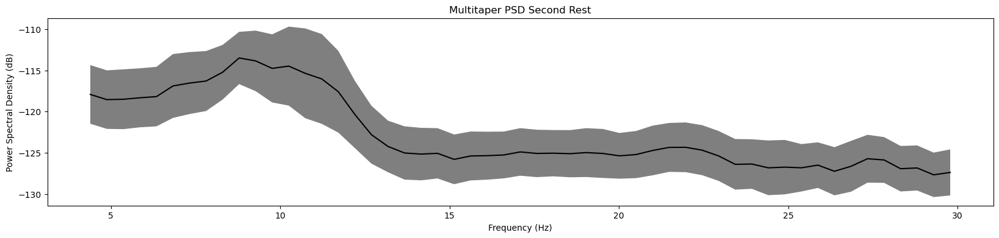

In [ ]:
psds, freqs = psd_secondrest.get_data(return_freqs=True)
#then convert to dB and take mean & standard deviation across channels
psds = 10 * np.log10(psds)
psds_mean = psds.mean(axis=0)
psds_std = psds.std(axis=0)


plt.figure(figsize = (20,4), dpi=100)
plt.title("Multitaper PSD Second Rest")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Power Spectral Density (dB)")
plt.plot(freqs, psds_mean, color="k")
plt.fill_between(
    freqs,
    psds_mean - psds_std,
    psds_mean + psds_std,
    color="k",
    alpha=0.5,
    edgecolor="none",
)
del(psds,psds_mean,psds_std, freqs)